# **Enhancing Pedestrian Safety in Melbourne's Urban Areas**



**Authored by :**  Dinuk

**Duration :** 90 mins

**Level :** Intermediate

**Pre-requisite Skills :** Python, Machine Learning


## Objective
The main goal of this project is to analyze traffic, pedestrian data, and weather conditions to identify patterns and factors that contribute to pedestrian safety. This analysis will help in enhancing safety measures and improving walking conditions.

## Acceptance Criteria

### Data Collection and Integration
- **Sources**: The system must integrate data from various sources including:
  - Weather conditions (temperature, UV index, rainfall).
  - Pedestrian counts.
  - Specific geographic locations.
  - Detailed topographical data to assess the steepness of pedestrian paths.
- **Timeliness**: Data should be updated over time to reflect the most current information available, ideally covering the past several months.

### Data Analysis and Reporting
- **Regression Analysis**: Implement a regression model to understand how various factors, such as weather conditions and specific locations, impact pedestrian safety.
- **Correlation Analysis**: Use correlation matrices to identify variables that are highly correlated to address potential issues of multicollinearity.
- **Pathway Calculation**: Develop algorithms to calculate the safest and most efficient pathways, minimizing steepness and exposure to potential hazards.

### Route Optimization and Mapping
- **GIS Technology**: Utilize Geographic Information Systems technology to map out optimized safety routes based on model findings.
- **Alternative Routes**: Provide alternative routes that balance steepness with environmental and urban factors, catering to personal preferences.

### Model Optimization
- **Dimensionality Reduction**: Apply PCA to manage data efficiency and complexity.
- **Regularization Methods**: Incorporate Ridge or Lasso regularization to handle multicollinearity and improve model performance.
- **Feature Selection**: Develop a feature selection strategy to eliminate redundant or irrelevant features to enhance model accuracy.

### Visualization and Decision Support
- **Visualization Dashboard**: Develop a dashboard to display traffic and pedestrian safety metrics across different times and locations, including heatmaps to highlight key correlations and trends.
- **Interactive Map**: Create an interactive map or application that provides route recommendations based on model insights.

### Feedback and Iteration
- **Feedback Loops**: Implement feedback loops to monitor the outcomes of safety measures, re-analyze data, and refine models based on effectiveness.

### Technical Notes
- **Data Privacy and Security**: Ensure the privacy and security of data, especially with real-time data integration.
- **Scalability**: Consider the scalability of the data processing infrastructure to handle increasing data volume.
- **Data Accuracy**: Ensure that the steepness data is accurate and regularly updated to reflect current pathway conditions.
- **Accessibility**: Consider the needs of all users, including those with disabilities, to ensure that routes are universally accessible.
.lysis and feedback.
 it.

At the end of this use case, I will have demonstrated a broad range of skills essential for data-driven urban planning and public safety enhancement. These include Data Integration, where I'll show the ability to merge and utilise data from diverse sources such as weather conditions, pedestrian counts, and geographic specifics in real-time or near-real-time. In Statistical Analysis and Modeling, I'll apply statistical techniques and regression models to dissect the impact of various environmental and urban factors on pedestrian safety, tackling issues like multicollinearity and data dimensionality using methods like PCA and regularisation.

M  work in Geospatial Analysis willhighlight hm  proficiency with GIS technology, enabling you to assess andoptimisee pedestrian routes based on topographical data like route steepness. In the realm of Machine Learning and Predictive ModelingIou'll refine predictive models to anticipate pedestrian traffic patterns and identify risk factors, enhancing model accuracy through careful feature selection.

Software Development skills will come into pyin developing interactive applications that advise users on safe pedestrian routes, integrating complex backend analytics with user-friendly interfaces. My focus on User-Centric Design and Feedback processes ensuresrat these tools are accessible and practical, incorporating user feedback for continuous improvemen

Promanagement and collaboration skills will be crucial to coordinating with stakeholders, including government bodies and public safety organisations, and ons, effectively communicating technical findings to inform and shape polFinallyFinMy, your understanding of Ethical and Privacy Considerations ensures that all data handling is conducted with the utmost respect for privacy and compliance with legal standards, establishing solutions that are not only effective but also ethically sound and securndards.

## <div class="usecase-section-header">Introduction / background relating to problem</div>

In modern urban environments, pedestrian safety is a crucial concern for city planners and public officials. As cities grow and traffic increases, the challenge of ensuring safe and accessible pedestrian pathways becomes increasingly complex. Addressing this issue requires a comprehensive understanding of the various factors that influence pedestrian safety, including geographic features, traffic patterns, and environmental conditions such as weather.

The use of data-driven approaches to urban planning offers a powerful tool to enhance pedestrian safety. By integrating and analyzing data from diverse sources—such as weather stations for real-time weather conditions, traffic sensors for vehicle and pedestrian counts, and GIS data for detailed geographic and topographical information—planners can identify high-risk areas, predict potential safety issues, and implement effective interventions.



## Packages

In this code chunk, I establish the environment and import all necessary libraries for data analysis, geospatial processing, visualization, and machine learning. By configuring environment variables and request caching, I ensure secure and efficient API interactions. The libraries I bring in allow me to handle and visualize data, perform spatial analysis and clustering, model and evaluate pedestrian safety, and calculate optimal routes using external APIs. This setup forms the backbone of the project, enabling comprehensive analysis and visualization to enhance pedestrian safety in Melbourne.

In [1]:
import os
import scipy
import json
import datetime
import folium
import numpy as np
import pandas as pd
import geopandas as gpd
import logging
import requests
import requests_cache
import matplotlib.pyplot as plt
from io import StringIO
from dotenv import load_dotenv
from IPython.display import display, clear_output, HTML
from ipywidgets import interact, widgets
from scipy.spatial.distance import cdist, pdist, squareform
from scipy.cluster.hierarchy import linkage, fcluster
from sklearn.neighbors import KDTree
from shapely.geometry import Point, LineString, Polygon, shape
from scipy.spatial.distance import euclidean
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor
import statsmodels.api as sm
from scipy.stats import linregress
import seaborn as sns
import networkx as nx
import openrouteservice
from openrouteservice import convert
from folium.plugins import HeatMap
from retry_requests import retry
import openmeteo_requests

# Load environment variables
load_dotenv()

# Set up requests cache
requests_cache.install_cache()


In [2]:
import warnings
warnings.filterwarnings('ignore')

## Footpath Steepness dataset

In this code chunk, I load the API key from environment variables to securely access the Melbourne Testbed API, which provides data on footpath steepness. By constructing a request URL and specifying parameters, I retrieve the dataset in CSV format using an HTTP GET request. The dataset, containing comprehensive information on footpath steepness, is then loaded into a pandas DataFrame for further analysis. The successful retrieval of data is validated by sampling a few records, ensuring that the data is correctly loaded and ready for processing. This step is crucial as it provides the foundational data necessary for the subsequent spatial and statistical analysis aimed at improving pedestrian safety in Melbourne.

In [3]:

load_dotenv()
api_key = os.environ.get("API_KEY_MOP")

base_url = 'https://melbournetestbed.opendatasoft.com/api/explore/v2.1/catalog/datasets/'
dataset_id = 'footpath-steepness'
apikey = api_key
dataset_id = dataset_id
format = 'csv'

params = {
    'select': '*',
    'limit': -1,  # all records
    'lang': 'en',
    'timezone': 'UTC',
    'api_key': apikey
}
url = f'{base_url}{dataset_id}/exports/{format}'
#GET request
response = requests.get(url, params=params)

if response.status_code == 200:
    # StringIO to read the CSV data
    url_content = response.content.decode('utf-8')
    footpath_steepness = pd.read_csv(StringIO(url_content), delimiter=';')
    print(footpath_steepness.sample(10, random_state=999)) # Test
else:
    print(f'Request failed with status code {response.status_code}')



                                  geo_point_2d  \
6939   -37.793531246364374, 144.94043501902428   
5502   -37.826686836876966, 144.97103418420872   
3964    -37.82336149873195, 144.96754168744584   
2188     -37.79942098354816, 144.9709189315643   
18168    -37.82859691392617, 144.9710174388107   
22798   -37.81911654327464, 144.95069698919994   
25768  -37.808123333372556, 144.95140983596548   
29434    -37.79447227001396, 144.9311697639647   
1798     -37.8009149408176, 144.96210417505176   
25796  -37.819037758767095, 144.96080691762364   

                                               geo_shape  grade1in  gradepc  \
6939   {"coordinates": [[[[144.94042678123358, -37.79...     160.1     0.62   
5502   {"coordinates": [[[[144.9710361192438, -37.826...      96.2     1.04   
3964   {"coordinates": [[[[144.96751421509197, -37.82...      45.0     2.22   
2188   {"coordinates": [[[[144.9712146619255, -37.799...      53.7     1.86   
18168  {"coordinates": [[[[144.9709873318095, -37.828.

In [4]:
footpath_steepness.head


<bound method NDFrame.head of                                   geo_point_2d  \
0      -37.823036142583945, 144.94866061456034   
1       -37.79542957518662, 144.91714933764632   
2        -37.79544286753349, 144.9172426574227   
3       -37.79580169415494, 144.92075182140118   
4       -37.79654832375531, 144.92328274904054   
...                                        ...   
33580   -37.82528644947733, 144.90971619143193   
33581    -37.8252692552434, 144.90973904472057   
33582  -37.794217597415205, 144.91881543737387   
33583   -37.793352986995224, 144.9309301120561   
33584   -37.78827197433308, 144.93918224198853   

                                               geo_shape  grade1in  gradepc  \
0      {"coordinates": [[[[144.94865791889143, -37.82...       4.2    23.81   
1      {"coordinates": [[[[144.9171360775573, -37.795...       NaN      NaN   
2      {"coordinates": [[[[144.917238930522, -37.7954...       NaN      NaN   
3      {"coordinates": [[[144.92074176246658, -37.795

## Microclimate data

In this code chunk, I retrieve microclimate sensor data from the Melbourne Testbed API by securely accessing it with an API key loaded from environment variables.

In [5]:
load_dotenv()
api_key = os.environ.get("API_KEY_MOP")

base_url = 'https://melbournetestbed.opendatasoft.com/api/explore/v2.1/catalog/datasets/'
dataset_id = 'microclimate-sensors-data'
apikey = api_key
dataset_id = dataset_id
format = 'csv'

params = {
    'select': '*',
    'limit': -1,  # all records
    'lang': 'en',
    'timezone': 'UTC',
    'api_key': apikey
}
url = f'{base_url}{dataset_id}/exports/{format}'
#GET request
response = requests.get(url, params=params)

if response.status_code == 200:
    # StringIO to read the CSV data
    url_content = response.content.decode('utf-8')
    microclimate_data = pd.read_csv(StringIO(url_content), delimiter=';')
    print(microclimate_data.sample(10, random_state=999)) # Test
else:
    print(f'Request failed with status code {response.status_code}')



                device_id                received_at  \
13363  ICTMicroclimate-08  2024-06-24T05:10:46+00:00   
404    ICTMicroclimate-08  2024-07-11T09:35:36+00:00   
63856  ICTMicroclimate-09  2024-08-23T06:30:37+00:00   
9548   ICTMicroclimate-09  2024-07-01T14:42:21+00:00   
59387  ICTMicroclimate-03  2024-08-09T03:33:08+00:00   
43099  ICTMicroclimate-08  2024-07-28T20:31:21+00:00   
18160  ICTMicroclimate-02  2024-06-20T09:15:43+00:00   
62449  ICTMicroclimate-07  2024-08-17T00:13:31+00:00   
70092  ICTMicroclimate-08  2024-08-28T20:40:20+00:00   
24801  ICTMicroclimate-06  2024-07-04T22:39:16+00:00   

                                          sensorlocation  \
13363  Swanston St - Tram Stop 13 adjacent Federation...   
404    Swanston St - Tram Stop 13 adjacent Federation...   
63856  SkyFarm (Jeff's Shed). Rooftop - Melbourne Con...   
9548   SkyFarm (Jeff's Shed). Rooftop - Melbourne Con...   
59387                                        CH1 rooftop   
43099  Swanston St - Tr

In [6]:
 microclimate_data.head

<bound method NDFrame.head of                 device_id                received_at  \
0      ICTMicroclimate-09  2024-07-17T15:33:32+00:00   
1      ICTMicroclimate-03  2024-07-17T15:06:13+00:00   
2      ICTMicroclimate-07  2024-07-17T15:21:33+00:00   
3      ICTMicroclimate-08  2024-07-17T15:40:34+00:00   
4      ICTMicroclimate-02  2024-07-17T15:42:47+00:00   
...                   ...                        ...   
87669  ICTMicroclimate-09  2024-09-18T01:53:01+00:00   
87670  ICTMicroclimate-06  2024-09-18T01:54:10+00:00   
87671  ICTMicroclimate-01  2024-09-18T01:58:23+00:00   
87672  ICTMicroclimate-03  2024-09-18T01:55:40+00:00   
87673  ICTMicroclimate-10  2024-09-18T02:03:46+00:00   

                                          sensorlocation  \
0      SkyFarm (Jeff's Shed). Rooftop - Melbourne Con...   
1                                            CH1 rooftop   
2      Tram Stop 7C - Melbourne Tennis Centre Precinc...   
3      Swanston St - Tram Stop 13 adjacent Federation... 

## Pedestrian monthly Counts per hour dataset

In this snippet, I retrieve hourly pedestrian count data from an API, which I then load into a pandas DataFrame for processing. This data is crucial for analysing pedestrian traffic patterns. I ensure the completeness of the time series by filling in any missing timestamps and replacing missing data with zeros. This preparation is essential for accurate analysis and modelling in my project aimed at enhancing pedestrian safety.

In [7]:
# Load environment variables
load_dotenv()
api_key = os.environ.get("API_KEY_MOP")

# Define the base URL and dataset parameters
base_url = 'https://melbournetestbed.opendatasoft.com/api/explore/v2.1/catalog/datasets/'
dataset_id = 'pedestrian-counting-system-monthly-counts-per-hour'
format = 'csv'

params = {
    'select': '*',
    'limit': -1,  # all records
    'lang': 'en',
    'timezone': 'UTC',
    'api_key': api_key
}

url = f'{base_url}{dataset_id}/exports/{format}'

# GET request to fetch data
response = requests.get(url, params=params)

if response.status_code == 200:
    # Read the CSV data from the response
    url_content = response.content.decode('utf-8')
    pedestrian_count = pd.read_csv(StringIO(url_content), delimiter=';')

    # Combine 'sensing_date' and 'hourday' to create a 'timestamp' column
    pedestrian_count['sensing_date'] = pd.to_datetime(pedestrian_count['sensing_date'])
    pedestrian_count['timestamp'] = pedestrian_count['sensing_date'] + pd.to_timedelta(pedestrian_count['hourday'], unit='h')

    # Generate a continuous range of hours between the min and max timestamps
    all_hours = pd.date_range(start=pedestrian_count['timestamp'].min(), end=pedestrian_count['timestamp'].max(), freq='1H')
    all_hours_df = pd.DataFrame({'timestamp': all_hours})
    
    # Merge with the original DataFrame to fill in missing rows
    pedestrian_count = pd.merge(all_hours_df, pedestrian_count, on='timestamp', how='left')
    
    # Fill NaN values with 0
    pedestrian_count.fillna(0, inplace=True)
    
    # Display the DataFrame
    print(pedestrian_count)

    # Print a sample of the data for testing
    print(pedestrian_count.sample(10, random_state=999))
    
else:
    print(f'Request failed with status code {response.status_code}')

                  timestamp            id  location_id         sensing_date  \
0       2021-07-01 00:00:00  2.802021e+10         28.0  2021-07-01 00:00:00   
1       2021-07-01 00:00:00  2.902021e+10         29.0  2021-07-01 00:00:00   
2       2021-07-01 00:00:00  9.020211e+09          9.0  2021-07-01 00:00:00   
3       2021-07-01 00:00:00  7.602021e+10         76.0  2021-07-01 00:00:00   
4       2021-07-01 00:00:00  4.802021e+10         48.0  2021-07-01 00:00:00   
...                     ...           ...          ...                  ...   
1850400 2024-09-17 03:00:00  1.432024e+10         14.0  2024-09-17 00:00:00   
1850401 2024-09-17 03:00:00  1.423202e+11        142.0  2024-09-17 00:00:00   
1850402 2024-09-17 03:00:00  6.132024e+10         61.0  2024-09-17 00:00:00   
1850403 2024-09-17 03:00:00  1.032024e+10         10.0  2024-09-17 00:00:00   
1850404 2024-09-17 03:00:00  6.332024e+10         63.0  2024-09-17 00:00:00   

         hourday  direction_1  direction_2  pedestr

In [8]:
zero_count = (pedestrian_count == 0).sum()
zero_count

timestamp              0
id                    12
location_id           12
sensing_date          12
hourday            72597
direction_1        35171
direction_2        35646
pedestriancount      248
sensor_name           12
location              12
dtype: int64

## Pedestrian Counting System - Past Hour (counts per minute) Dataset

In this code chunk, I fetch pedestrian counting data from the Melbourne Testbed API, which tracks the number of pedestrians counted per minute over the past hour. By securely loading the API key from environment variables, I ensure that sensitive information remains protected. The code constructs a request URL with appropriate parameters to download the dataset in CSV format.

In [9]:
load_dotenv()
api_key = os.environ.get("API_KEY_MOP")

base_url = 'https://melbournetestbed.opendatasoft.com/api/explore/v2.1/catalog/datasets/'
dataset_id = 'pedestrian-counting-system-past-hour-counts-per-minute'
apikey = api_key
dataset_id = dataset_id
format = 'csv'

params = {
    'select': '*',
    'limit': -1,  # all records
    'lang': 'en',
    'timezone': 'UTC',
    'api_key': apikey
}
url = f'{base_url}{dataset_id}/exports/{format}'
#GET request
response = requests.get(url, params=params)

if response.status_code == 200:
    # StringIO to read the CSV data
    url_content = response.content.decode('utf-8')
    pedestrian_count_min = pd.read_csv(StringIO(url_content), delimiter=';')
    print(pedestrian_count_min.sample(10, random_state=999)) # Test
else:
    print(f'Request failed with status code {response.status_code}')



        location_id           sensing_datetime sensing_date sensing_time  \
48743            47  2024-09-15T05:34:00+00:00   2024-09-15        15:34   
147979          108  2024-09-16T21:29:00+00:00   2024-09-17        07:29   
137809           27  2024-09-16T21:50:00+00:00   2024-09-17        07:50   
55342            10  2024-09-16T03:02:00+00:00   2024-09-16        13:02   
194870          109  2024-09-17T23:40:00+00:00   2024-09-18        09:40   
199960           85  2024-09-17T20:37:00+00:00   2024-09-18        06:37   
24257            28  2024-09-15T22:38:00+00:00   2024-09-16        08:38   
189047           14  2024-09-17T15:54:00+00:00   2024-09-18        01:54   
162812            9  2024-09-16T20:51:00+00:00   2024-09-17        06:51   
147729           76  2024-09-16T21:55:00+00:00   2024-09-17        07:55   

        direction_1  direction_2  total_of_directions  
48743            26           30                   56  
147979            1           26                   

This code filters the pedestrian counting data to retain only records at the top of each hour by selecting rows where the minute value is zero. This conversion to hourly data (hourly_df) simplifies the analysis of pedestrian trends over time, making it more suitable for understanding broader movement patterns in urban planning.

In [10]:
# Filter rows where the minute and second are zer
pedestrian_count_min['sensing_datetime'] = pd.to_datetime(pedestrian_count_min['sensing_datetime'])
hourly_df = pedestrian_count_min[pedestrian_count_min['sensing_datetime'].dt.minute == 0]
hourly_df

,location_id,sensing_datetime,sensing_date,sensing_time,direction_1,direction_2,total_of_directions
1,107,2024-09-15 14:00:00+00:00,2024-09-16,00:00,2,2,4
6,131,2024-09-15 14:00:00+00:00,2024-09-16,00:00,2,0,2
8,134,2024-09-15 14:00:00+00:00,2024-09-16,00:00,3,15,18
49,6,2024-09-15 14:00:00+00:00,2024-09-16,00:00,1,5,6
52,14,2024-09-15 14:00:00+00:00,2024-09-16,00:00,3,1,4
...,...,...,...,...,...,...,...
216551,79,2024-09-18 02:00:00+00:00,2024-09-18,12:00,2,11,13
216573,85,2024-09-18 02:00:00+00:00,2024-09-18,12:00,1,0,1
216621,137,2024-09-18 02:00:00+00:00,2024-09-18,12:00,2,8,10
216634,141,2024-09-18 02:00:00+00:00,2024-09-18,12:00,20,7,27


In this code, I convert the sensing_datetime column to a datetime format to facilitate time-based analysis. I then determine the earliest and latest timestamps in the dataset, which helps establish the timeframe covered by the pedestrian counting data. This step is crucial for understanding the temporal scope of the data, allowing me to analyze pedestrian trends within a defined period.

In [11]:
# Convert 'timestamp' column to datetime
pedestrian_count_min['sensing_datetimep'] = pd.to_datetime(pedestrian_count_min['sensing_datetime'])

earliest_timestamp = pedestrian_count_min['sensing_datetime'].min()
latest_timestamp = pedestrian_count_min['sensing_datetime'].max()

print("Earliest Timestamp:", earliest_timestamp)
print("Latest Timestamp:", latest_timestamp)

Earliest Timestamp: 2024-09-14 13:55:00+00:00
Latest Timestamp: 2024-09-18 02:55:00+00:00


## Pedestrian Couting System Locations dataset

In this code snippet, I access pedestrian sensor location data from an open data API to enhance my analysis of pedestrian traffic patterns. After successfully fetching the data, I convert it into a pandas DataFrame to facilitate further analysis, such as mapping sensor locations using GIS technology. This process is critical for accurately determining the distribution of pedestrian traffic and planning safety measures effectively in my data-driven urban planning project.

In [12]:
load_dotenv()
api_key = os.environ.get("API_KEY_MOP")

base_url = 'https://melbournetestbed.opendatasoft.com/api/explore/v2.1/catalog/datasets/'
dataset_id = 'pedestrian-counting-system-sensor-locations'
apikey = api_key
dataset_id = dataset_id
format = 'csv'

params = {
    'select': '*',
    'limit': -1,  # all records
    'lang': 'en',
    'timezone': 'UTC',
    'api_key': apikey
}
url = f'{base_url}{dataset_id}/exports/{format}'
# GET request
response = requests.get(url, params=params)

if response.status_code == 200:
    # StringIO to read the CSV data
    url_content = response.content.decode('utf-8')
    pedestrian_sensor_locations = pd.read_csv(StringIO(url_content), delimiter=';')
    print(pedestrian_sensor_locations.sample(10, random_state=999)) # Test
else:
    print(f'Request failed with status code {response.status_code}')

     location_id                              sensor_description  \
55            44                    Tin Alley-Swanston St (West)   
41           138  COM Pole 1671 - Enterprize Park, Queens Bridge   
24            78            Harbour Esplanade (West) - Bike Path   
59            50                      Faraday St-Lygon St (West)   
37           118           114 Flinders Street Car Park Crossing   
82           150   narrm ngarrgu Library - Level 1 Main Stairs B   
28            85                             Macaulay Rd (North)   
107           54                         Lincoln-Swanston (West)   
64            67                Flinders Ln -Degraves St (South)   
29            90                     Boyd Community Hub- Library   

       sensor_name installation_date                         note  \
55           UM3_T        2015-04-15  Pushbox Upgrade, 30/06/2023   
41   EntPark1671_T        2023-11-20                          NaN   
24        HarEsB_T        2021-03-30        

## Street Names Dataset

In this snippet, I utilize API data to fetch a list of street names in CSV format, which I load into a pandas DataFrame. This information is essential for associating geographic and traffic data with specific street locations, allowing for a more granular analysis of pedestrian safety across different areas. This method ensures that my urban planning project effectively utilizes real-time data for decision-making and planning interventions.

In [13]:
load_dotenv()
api_key = os.environ.get("API_KEY_MOP")

base_url = 'https://melbournetestbed.opendatasoft.com/api/explore/v2.1/catalog/datasets/'
dataset_id = 'street-names'
apikey = api_key
dataset_id = dataset_id
format = 'csv'

params = {
    'select': '*',
    'limit': -1,  # all records
    'lang': 'en',
    'timezone': 'UTC',
    'api_key': apikey
}
url = f'{base_url}{dataset_id}/exports/{format}'
# GET request
response = requests.get(url, params=params)

if response.status_code == 200:
    # StringIO to read the CSV data
    url_content = response.content.decode('utf-8')
    street_names = pd.read_csv(StringIO(url_content), delimiter=';')
    print(street_names.sample(10, random_state=999)) # Test
else:
    print(f'Request failed with status code {response.status_code}')

                                 geo_point_2d  \
680       -37.8063424022535, 144.944400840844   
782       -37.7922130265025, 144.939455640246   
2121   -37.80603335366346, 144.94330724359577   
1073   -37.84057585833539, 145.00460081586272   
1278   -37.79342942689862, 144.91844441272363   
2211    -37.794507128057504, 144.920538630693   
303   -37.795323682507004, 144.94622660323301   
896        -37.809746212595, 144.946085238719   
2552       -37.821777475467, 144.935491325427   
809    -37.79263026699863, 144.91941442142388   

                                              geo_shape  mccid_gis  \
680   {"coordinates": [[144.944487580612, -37.806378...        310   
782   {"coordinates": [[144.942059049471, -37.792498...         35   
2121  {"coordinates": [[144.943140438154, -37.805906...        865   
1073  {"coordinates": [[144.995482513629, -37.839488...        368   
1278  {"coordinates": [[144.918035092016, -37.792981...         30   
2211  {"coordinates": [[144.920598774622

In [14]:
street_names

,geo_point_2d,geo_shape,mccid_gis,maplabel,name,mccid_str,xdate
0,"-37.83011414410377, 144.95268063216","{""coordinates"": [[144.95328861584, -37.8298049...",39,NaN,BUCKHURST LA,STREET_NAME_EXT_5000_Label,20160122
1,"-37.774964845363, 144.938994281833","{""coordinates"": [[144.938916491966, -37.775396...",65,NaN,GIBSON AV,STREET_NAME_EXT_10000_Label,20160122
2,"-37.833624678099, 144.9483213738935","{""coordinates"": [[144.948253784366, -37.833456...",63,NaN,BARKLY AV,STREET_NAME_EXT_5000_Label,20160122
3,"-37.800287679660904, 144.9549082867173","{""coordinates"": [[144.954700495049, -37.800111...",21,Wreckyn Place,WRECKYN PLACE,Street_Label_2000,20210923
4,"-37.7821603522835, 144.9074255254285","{""coordinates"": [[144.907011990752, -37.781713...",31,NaN,CHAUVEL ST,STREET_NAME_EXT_10000_Label,20160122
...,...,...,...,...,...,...,...
2871,"-37.796458014327, 144.949704329739","{""coordinates"": [[144.949513460746, -37.796304...",545,Chapman Lane,CHAPMAN LANE,Street_Label_2000,20210923
2872,"-37.80929597646273, 144.95041403139217","{""coordinates"": [[144.95036270025, -37.8092539...",1292,CL1115,CL1115,Street_Label_2000,20210923
2873,"-37.822414318054754, 144.9373137961169","{""coordinates"": [[144.940627978509, -37.823345...",4,South Wharf Drive,SOUTH WHARF DRIVE,Street_Label_10000,20210923
2874,"-37.79208682782973, 144.92245047769802","{""coordinates"": [[144.92211162733, -37.7922716...",671,Gardner Lane,GARDNER LANE,Street_Label_2000,20210923


## Merge pedestrian counts and locations

In this code snippet, I merge two datasets: pedestrian count data and sensor location data, using a common key (`locationid` from the pedestrian count data and `location_id` from the sensor location data). This merged DataFrame enables me to analyze pedestrian counts in the context of their specific locations, which is crucial for spatial analysis in my project. 

In [15]:
pedestrian_merged_data = pd.merge(hourly_df, pedestrian_sensor_locations, left_on='location_id', right_on='location_id', how='inner')
# pedestrian_merged_data.sort_values(by='timestamp',ascending=False)



## Find the earliest and latest timestamps

In this code, I convert the 'timestamp' column of our pedestrian data to a datetime format for easier analysis. Then, I extract and display the earliest and latest timestamps to assess the temporal range of the data, ensuring that our analysis is timely and relevant for current urban planning needs.

In [16]:
# Convert 'timestamp' column to datetime
pedestrian_merged_data['sensing_datetime'] = pd.to_datetime(pedestrian_merged_data['sensing_datetime'])

earliest_timestamp = pedestrian_merged_data['sensing_datetime'].min()
latest_timestamp = pedestrian_merged_data['sensing_datetime'].max()

print("Earliest Timestamp:", earliest_timestamp)
print("Latest Timestamp:", latest_timestamp)


Earliest Timestamp: 2024-09-14 14:00:00+00:00
Latest Timestamp: 2024-09-18 02:00:00+00:00


## Filter data by date (Last Month)

This code filters the pedestrian data to include only records from the last month. By setting the end_date to today and the start_date to one month prior, I create a time range for filtering. I then extract the date from the sensing_datetime column and filter the dataset (pedestrian_merged_data) to keep only the entries within this one month. The resulting filtered_data_last_month DataFrame provides a focused view of pedestrian activity over the past month, which is useful for recent trend analysis and short-term planning.

In [17]:
# Define the end date as today
end_date = pd.Timestamp.today().date()

# Define the start date as one month before the end date
start_date = (pd.Timestamp.today() - pd.DateOffset(months=1)).date()

# Extract date from 'timestamp' column
pedestrian_merged_data['date_only'] = pedestrian_merged_data['sensing_datetime'].dt.date

# Filter the combined data DataFrame by the last month
filtered_data_last_month = pedestrian_merged_data[
    (pedestrian_merged_data['date_only'] >= start_date) & 
    (pedestrian_merged_data['date_only'] <= end_date)
]

# Display the filtered data for the last month
print("Filtered data for the last month:")
print(filtered_data_last_month.head())


Filtered data for the last month:
   location_id          sensing_datetime sensing_date sensing_time  \
0          107 2024-09-15 14:00:00+00:00   2024-09-16        00:00   
1          107 2024-09-15 12:00:00+00:00   2024-09-15        22:00   
2          107 2024-09-15 05:00:00+00:00   2024-09-15        15:00   
3          107 2024-09-15 01:00:00+00:00   2024-09-15        11:00   
4          107 2024-09-15 00:00:00+00:00   2024-09-15        10:00   

   direction_1_x  direction_2_x  total_of_directions  \
0              2              2                    4   
1              0              1                    1   
2              9             11                   20   
3             17              4                   21   
4              9             10                   19   

         sensor_description sensor_name installation_date note location_type  \
0  Flagstaff station (East)   280Will_T        2022-10-08  NaN       Outdoor   
1  Flagstaff station (East)   280Will_T        2

In [18]:
filtered_data_last_month.rename(columns={'sensing_datetime': 'timestamp'}, inplace=True)

## Request climate data through API using latitude and longitude data

<!--This code extracts the first values of latitude and longitude from the pedestrian sensor locations dataset, storing them as variables. This step is typically used to set a reference point or initial map focus when visualizing geographic data related to pedestrian movement.

In this code snippet, I extract the latitude and longitude coordinates of a specific pedestrian sensor location by accessing the first row's values in the pedestrian_sensor_locations DataFrame. These coordinates (pedestrian_latitude and pedestrian_longitude) are crucial for mapping the sensor's location and integrating it with other spatial data, such as climate data. This step enables geographic analysis and visualization, allowing for a better understanding of pedestrian activity at specific locations.

In [19]:
pedestrian_latitude = pedestrian_sensor_locations['latitude'].values[0]
pedestrian_longitude = pedestrian_sensor_locations['longitude'].values[0]

<!--This code snippet is designed to fetch and process climate data for multiple pedestrian sensor locations using the Open-Meteo API. It starts by setting up a cached and retry-enabled session to handle API requests efficiently. A function `get_climate_data` is defined to retrieve hourly climate data, including temperature, humidity, precipitation, and UV index, for given latitude and longitude coordinates. This data is then organized into a DataFrame. 

For each pedestrian sensor location, the function is called to gather climate data, which is then appended to a list. Finally, all individual DataFrames are concatenated into one comprehensive DataFrame, which is adjusted to rename the 'date' column to 'timestamp' for consistency with other data elements in the project. This integration enables a detailed analysis of how weather conditions correlate with pedestrian movement patterns, enhancing the project's insights into pedestrian safety under various environmental conditions.

### Open-Meteo API

In this code chunk, I set up a client to retrieve climate data using the Open-Meteo API, ensuring robust data collection with caching and retry mechanisms in case of errors. The get_climate_data function fetches hourly climate variables—such as temperature, humidity, and precipitation—based on the latitude and longitude of pedestrian sensor locations. The data is processed and stored in a pandas DataFrame, where each row represents hourly climate conditions for a specific location.

The process is repeated for all sensor locations, and the resulting data is combined into a single DataFrame, climate_data_combined. This dataset is essential for integrating weather conditions with pedestrian and footpath data, allowing for a comprehensive analysis of how microclimate factors might impact pedestrian activity and safety in different parts of Melbourne.

In [20]:
# Setup the Open-Meteo API client with cache and retry on error
cache_session = requests_cache.CachedSession('.cache', expire_after=3600)
retry_session = retry(cache_session, retries=5, backoff_factor=0.2)
openmeteo = openmeteo_requests.Client(session=retry_session)

def get_climate_data(latitude, longitude):
    url = "https://api.open-meteo.com/v1/forecast"
    params = {
        "latitude": pedestrian_latitude,
        "longitude": pedestrian_longitude,
        "current": "relative_humidity_2m",
        "hourly": ["temperature_2m", "relative_humidity_2m", "precipitation", "rain", "showers", "weather_code", "uv_index"],
        "past_days": 92
    }
    responses = openmeteo.weather_api(url, params=params)

    # Process first location. Add a for-loop for multiple locations or weather models
    response = responses[0]

    # Process hourly data
    hourly = response.Hourly()
    hourly_temperature_2m = hourly.Variables(0).ValuesAsNumpy()
    hourly_relative_humidity_2m = hourly.Variables(1).ValuesAsNumpy()
    hourly_precipitation = hourly.Variables(2).ValuesAsNumpy()
    hourly_rain = hourly.Variables(3).ValuesAsNumpy()
    hourly_showers = hourly.Variables(4).ValuesAsNumpy()
    hourly_weather_code = hourly.Variables(5).ValuesAsNumpy()
    hourly_uv_index = hourly.Variables(6).ValuesAsNumpy()

    hourly_data = {
        "latitude": latitude,
        "longitude": longitude,
        "date": pd.date_range(
            start=pd.to_datetime(hourly.Time(), unit="s", utc=True),
            end=pd.to_datetime(hourly.TimeEnd(), unit="s", utc=True),
            freq=pd.Timedelta(seconds=hourly.Interval()),
            inclusive="left"
        ),
        "temperature_2m": hourly_temperature_2m,
        "relative_humidity_2m": hourly_relative_humidity_2m,
        "precipitation": hourly_precipitation,
        "rain": hourly_rain,
        "showers": hourly_showers,
        "weather_code": hourly_weather_code,
        "uv_index": hourly_uv_index
    }

    hourly_dataframe = pd.DataFrame(data=hourly_data)
    return hourly_dataframe


# Initialize an empty list to store all climate dataframes
all_climate_data = []

# Iterate over each location and retrieve climate data
for index, row in pedestrian_sensor_locations.iterrows():
    latitude = row['latitude']
    longitude = row['longitude']
   
    climate_data = get_climate_data(latitude, longitude)
    all_climate_data.append(climate_data)

# Concatenate all climate dataframes into a single dataframe
climate_data_combined = pd.concat(all_climate_data, ignore_index=True)

# Print the combined climate data

climate_data_combined = climate_data_combined.rename(columns={'date': 'timestamp'})
climate_data_combined

,latitude,longitude,timestamp,temperature_2m,relative_humidity_2m,precipitation,rain,showers,weather_code,uv_index
0,-37.813494,144.965153,2024-06-19 00:00:00+00:00,5.567000,73.0,0.0,0.0,0.0,1.0,1.25
1,-37.813494,144.965153,2024-06-19 01:00:00+00:00,8.017000,65.0,0.0,0.0,0.0,1.0,2.10
2,-37.813494,144.965153,2024-06-19 02:00:00+00:00,10.066999,59.0,0.0,0.0,0.0,0.0,2.55
3,-37.813494,144.965153,2024-06-19 03:00:00+00:00,11.266999,56.0,0.0,0.0,0.0,0.0,2.45
4,-37.813494,144.965153,2024-06-19 04:00:00+00:00,12.016999,48.0,0.0,0.0,0.0,1.0,2.45
...,...,...,...,...,...,...,...,...,...,...
316003,-37.817724,144.950255,2024-09-25 19:00:00+00:00,4.467000,85.0,0.0,0.0,0.0,2.0,0.00
316004,-37.817724,144.950255,2024-09-25 20:00:00+00:00,4.067000,84.0,0.0,0.0,0.0,2.0,0.00
316005,-37.817724,144.950255,2024-09-25 21:00:00+00:00,4.417000,81.0,0.0,0.0,0.0,2.0,0.05
316006,-37.817724,144.950255,2024-09-25 22:00:00+00:00,6.267000,74.0,0.0,0.0,0.0,2.0,0.75


In this code chunk, I prepare and filter the climate data to focus on the most recent month. First, I convert the timestamp column to a timezone-aware datetime format (UTC). Then, I define the analysis period by setting the end_date to the current date and calculating the start_date as one month prior. I filter the climate data (climate_data_combined) to include only records within this one-month period, resulting in filtered_climate_data_last_month. This filtered dataset provides a focused view of recent climate conditions, which is crucial for analyzing how current weather patterns might influence pedestrian behavior and safety.

In [21]:
# Convert 'timestamp' to datetime with timezone
climate_data_combined['timestamp'] = pd.to_datetime(climate_data_combined['timestamp']).dt.tz_convert('UTC')

# Define the end date as today
end_date = pd.Timestamp.now(tz='UTC')

# Define the start date as one month before the end date
start_date = end_date - pd.DateOffset(months=1)

# Filter the DataFrame for the last month
filtered_climate_data_last_month = climate_data_combined[
    (climate_data_combined['timestamp'] >= start_date) & 
    (climate_data_combined['timestamp'] <= end_date)
]

# Display the filtered data for the last month
filtered_climate_data_last_month.head()

,latitude,longitude,timestamp,temperature_2m,relative_humidity_2m,precipitation,rain,showers,weather_code,uv_index
1465,-37.813494,144.965153,2024-08-19 01:00:00+00:00,13.367000,73.0,0.0,0.0,0.0,1.0,3.50
1466,-37.813494,144.965153,2024-08-19 02:00:00+00:00,16.317001,63.0,0.0,0.0,0.0,1.0,4.25
1467,-37.813494,144.965153,2024-08-19 03:00:00+00:00,17.867001,58.0,0.0,0.0,0.0,2.0,4.50
1468,-37.813494,144.965153,2024-08-19 04:00:00+00:00,18.467001,54.0,0.0,0.0,0.0,2.0,3.05
1469,-37.813494,144.965153,2024-08-19 05:00:00+00:00,18.067001,57.0,0.0,0.0,0.0,1.0,1.30


## Check the time range

In [22]:
# Convert 'timestamp' column to datetime if needed
filtered_climate_data_last_month['timestamp'] = pd.to_datetime(filtered_climate_data_last_month['timestamp'])

# Find the earliest and latest timestamps
earliest_timestamp = filtered_climate_data_last_month['timestamp'].min()
latest_timestamp = filtered_climate_data_last_month['timestamp'].max()

print("Earliest Timestamp:", earliest_timestamp)
print("Latest Timestamp:", latest_timestamp)

Earliest Timestamp: 2024-08-19 01:00:00+00:00
Latest Timestamp: 2024-09-19 00:00:00+00:00


## Merge pedestrian dataset with climate dataset on timestamp and location data

In [23]:
merged_data = pd.merge(filtered_climate_data_last_month, filtered_data_last_month, on=['timestamp', 'latitude', 'longitude'])
merged_data

,latitude,longitude,timestamp,temperature_2m,relative_humidity_2m,precipitation,rain,showers,weather_code,uv_index,...,sensor_description,sensor_name,installation_date,note,location_type,status,direction_1_y,direction_2_y,location,date_only
0,-37.813494,144.965153,2024-09-14 14:00:00+00:00,8.367000,75.0,0.0,0.0,0.0,2.0,0.00,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-14
1,-37.813494,144.965153,2024-09-14 21:00:00+00:00,7.567000,78.0,0.0,0.0,0.0,2.0,0.05,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-14
2,-37.813494,144.965153,2024-09-15 00:00:00+00:00,11.117000,56.0,0.0,0.0,0.0,2.0,3.55,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-15
3,-37.813494,144.965153,2024-09-15 01:00:00+00:00,11.917000,50.0,0.0,0.0,0.0,2.0,4.75,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-15
4,-37.813494,144.965153,2024-09-15 02:00:00+00:00,12.316999,48.0,0.0,0.0,0.0,2.0,5.55,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6049,-37.819973,144.958349,2024-09-17 22:00:00+00:00,8.667000,62.0,0.0,0.0,0.0,0.0,1.00,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-17
6050,-37.819973,144.958349,2024-09-17 23:00:00+00:00,11.066999,55.0,0.0,0.0,0.0,0.0,2.40,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-17
6051,-37.819973,144.958349,2024-09-18 00:00:00+00:00,15.117000,40.0,0.0,0.0,0.0,0.0,3.95,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-18
6052,-37.819973,144.958349,2024-09-18 01:00:00+00:00,17.767000,29.0,0.0,0.0,0.0,0.0,5.25,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-18


## Reindexing the dataframe

In [25]:
#merged_data = merged_data.reindex(columns=['latitude', 'longitude','timestamp','location_id', 'direction_1_x', 'direction_2_x', 'total_of_directions', 'direction_1_y', 'direction_2_y','temperature_2m','relative_humidity_2m', 'precipitation', 'rain', 'showers','weather_code', 'uv_index', ]) 
merged_data

,latitude,longitude,timestamp,temperature_2m,relative_humidity_2m,precipitation,rain,showers,weather_code,uv_index,...,sensor_description,sensor_name,installation_date,note,location_type,status,direction_1_y,direction_2_y,location,date_only
0,-37.813494,144.965153,2024-09-14 14:00:00+00:00,8.367000,75.0,0.0,0.0,0.0,2.0,0.00,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-14
1,-37.813494,144.965153,2024-09-14 21:00:00+00:00,7.567000,78.0,0.0,0.0,0.0,2.0,0.05,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-14
2,-37.813494,144.965153,2024-09-15 00:00:00+00:00,11.117000,56.0,0.0,0.0,0.0,2.0,3.55,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-15
3,-37.813494,144.965153,2024-09-15 01:00:00+00:00,11.917000,50.0,0.0,0.0,0.0,2.0,4.75,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-15
4,-37.813494,144.965153,2024-09-15 02:00:00+00:00,12.316999,48.0,0.0,0.0,0.0,2.0,5.55,...,Bourke Street Mall (North),Bou292_T,2009-03-24,NaN,Outdoor,A,East,West,"-37.81349441, 144.96515323",2024-09-15
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6049,-37.819973,144.958349,2024-09-17 22:00:00+00:00,8.667000,62.0,0.0,0.0,0.0,0.0,1.00,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-17
6050,-37.819973,144.958349,2024-09-17 23:00:00+00:00,11.066999,55.0,0.0,0.0,0.0,0.0,2.40,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-17
6051,-37.819973,144.958349,2024-09-18 00:00:00+00:00,15.117000,40.0,0.0,0.0,0.0,0.0,3.95,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-18
6052,-37.819973,144.958349,2024-09-18 01:00:00+00:00,17.767000,29.0,0.0,0.0,0.0,0.0,5.25,...,Awning of Nationwide Parking 474 Flinders Street,474Fl_T,2023-11-10,NaN,Outdoor,A,East,West,"-37.81997273, 144.95834911",2024-09-18


## Check the time range

In [26]:
# Find the earliest and latest timestamps
earliest_timestamp = merged_data['timestamp'].min()
latest_timestamp = merged_data['timestamp'].max()

print("Earliest Timestamp:", earliest_timestamp)
print("Latest Timestamp:", latest_timestamp)

Earliest Timestamp: 2024-09-14 14:00:00+00:00
Latest Timestamp: 2024-09-18 02:00:00+00:00


## Create a base map centered around Melbourne

<!--This code snippet creates an interactive map centered on Melbourne using Folium, a Python library ideal for geographic visualizations. The map is initially set to a specific zoom level to provide a detailed view of the city. It then processes the DataFrame for the week labeled 'January_4' from your merged data collections, filtering out duplicate entries for latitude and longitude to ensure each location is marked uniquely on the map.

Markers are added to the map for each unique coordinate, pinpointing the exact locations of pedestrian sensors. This visualization helps in understanding the geographic distribution of pedestrian traffic and can be crucial for identifying areas that may require additional safety measures. Although the code to save the map as an HTML file is commented out, executing that line would allow you to share or view the map independently of the Python environment. This map offers a powerful tool for both presentation and further analysis of pedestrian safety and traffic patterns in Melbourne.

In this code, I create an interactive map centered on Melbourne using Folium. The code filters out duplicate latitude and longitude coordinates from the merged_data dataset to ensure each location is represented only once on the map. I then add markers for each unique location, visually indicating the positions of interest across the city. This map provides a clear geographic overview of the key locations involved in the analysis, which could include pedestrian sensors, footpaths, or climate data points. It serves as a foundational tool for exploring spatial patterns and relationships in the data.

In [27]:
melbourne_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=14)

# Filter out duplicate latitude and longitude coordinates
unique_coordinates = merged_data[['latitude', 'longitude']].drop_duplicates().values.tolist()

# Add unique coordinates as markers on the map
for lat, lon in unique_coordinates:
    folium.Marker(location=[lat, lon]).add_to(melbourne_map)
melbourne_map

## Total of Directions Heat Map for selected date

<!--This code enables interactive visualization of pedestrian traffic data on a Melbourne map. Users can select a date, and a heatmap reflecting pedestrian traffic for that day is dynamically generated and displayed. The setup uses a date picker widget for easy date selection and a function to update the map accordingly, enhancing the analysis and planning of urban pedestrian safety measures.

In [28]:
# Function to update the map based on the selected date
def update_map(selected_date):
    selected_day_df = merged_data[merged_data['timestamp'].dt.date == selected_date]
    pedestrian_data = selected_day_df[['latitude', 'longitude', 'total_of_directions']].values.tolist()
    
    # Create base map centered around Melbourne
    melbourne_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=16)

    # Add heatmap layer using pedestrian data
    HeatMap(pedestrian_data).add_to(melbourne_map)

    # Save the map as HTML
    # melbourne_map.save("melbourne_heatmap.html")
    display(melbourne_map)

# Create a widget to select the date
date_picker = widgets.DatePicker(description='Select Date', disabled=False)

# Display the time range
print("Pick a date last 30 days:")

# Display the widget and the interactive map
interact(update_map, selected_date=date_picker);


Pick a date last 30 days:


interactive(children=(DatePicker(value=None, description='Select Date', step=1), Output()), _dom_classes=('wid…

## HeatMap with Climate Data for selected date

This code allows for an interactive exploration of pedestrian and climate data on a map, based on a user-selected date. The update_map function filters the merged dataset for the chosen date and visualizes the data on a Folium map centered on Melbourne. A heatmap layer is added to represent pedestrian activity, showing areas of high foot traffic. Additional heatmap layers visualize different climate variables, such as humidity, precipitation, rain, showers, and UV index, allowing users to explore the relationship between weather conditions and pedestrian activity. A date picker widget enables users to easily select a specific date, updating the map accordingly. This interactive tool is key for analyzing daily variations in pedestrian behavior and how they correlate with weather patterns, aiding in the identification of trends that can inform urban planning and safety strategies.

In [29]:
# Function to update the map based on the selected date
def update_map(selected_date):
    # Filter data for the selected date
    selected_day_df = merged_data[merged_data['timestamp'].dt.date == selected_date]
    
    # Extract pedestrian data
    pedestrian_data = selected_day_df[['latitude', 'longitude', 'total_of_directions']].values.tolist()
    
    # Create base map centered around Melbourne
    melbourne_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=16)
    
    # Add heatmap layer for pedestrian data
    HeatMap(pedestrian_data, name='Pedestrian Heatmap').add_to(melbourne_map)
    
    # Add climate data layers
    climate_layers = {
        'Relative Humidity 2m': 'relative_humidity_2m',
        'Precipitation': 'precipitation',
        'Rain': 'rain',
        'Showers': 'showers',
        'UV Index': 'uv_index'
    }
    
    for layer_name, layer_column in climate_layers.items():
        climate_data = selected_day_df[['latitude', 'longitude', layer_column]].values.tolist()
        HeatMap(climate_data, name=layer_name).add_to(melbourne_map)

    # Add layer control
    folium.LayerControl().add_to(melbourne_map)

    # melbourne_map.save("melbourne_heatmap.html")
    display(melbourne_map)

merged_data.dropna(inplace=True)

# Get unique dates from the DataFrame
unique_dates = merged_data['timestamp'].dt.date.unique()

# Create a widget to select the date
date_picker = widgets.DatePicker(description='Select Date', disabled=False)


# Display the time range
print("Time Range:")
print("Earliest Timestamp:", earliest_timestamp)
print("Latest Timestamp:", latest_timestamp)

# Display the widget and the interactive map
interact(update_map, selected_date=date_picker);



Time Range:
Earliest Timestamp: 2024-09-14 14:00:00+00:00
Latest Timestamp: 2024-09-18 02:00:00+00:00


interactive(children=(DatePicker(value=None, description='Select Date', step=1), Output()), _dom_classes=('wid…

<!--This code calculates and displays summary statistics for the missing values (NaN) across all columns in a specified weekly DataFrame. It helps in assessing the extent of missing data, which is crucial for planning data cleaning and preprocessing steps effectively.

In this code, I calculate summary statistics for the distribution of missing values (NaNs) across the merged_data DataFrame.

In [30]:
# Calculate summary statistics of NaN values
nan_dispersion = merged_data.isnull().sum().describe()
print(nan_dispersion)

count    26.0
mean      0.0
std       0.0
min       0.0
25%       0.0
50%       0.0
75%       0.0
max       0.0
dtype: float64


## Drop NaN values 

<!--This code snippet removes rows with missing values from a specified weekly DataFrame and then calculates summary statistics for the cleaned data. These statistics provide insights into the central tendency, dispersion, and shape of the dataset’s distribution, aiding in data analysis and decision-making. The summary is then printed, offering a detailed overview of the available data’s characteristics.

In [31]:
# Drop NaN values
cleaned_df = merged_data.dropna()

# Summary statistics of the available data
summary = cleaned_df.describe()

# Print the summary statistics
print(summary)


          latitude    longitude  temperature_2m  relative_humidity_2m  \
count  1572.000000  1572.000000     1572.000000           1572.000000   
mean    -37.812449   144.965619       11.542317             63.357506   
std       0.006253     0.004357        2.687549             14.680360   
min     -37.820178   144.954527        6.817000             26.000000   
25%     -37.818742   144.962578        9.217000             50.750000   
50%     -37.813625   144.966094       11.967000             66.000000   
75%     -37.809993   144.968729       12.816999             75.000000   
max     -37.796987   144.973297       18.817001             91.000000   

       precipitation         rain      showers  weather_code     uv_index  \
count    1572.000000  1572.000000  1572.000000    1572.00000  1572.000000   
mean        0.026018     0.019275     0.006743       7.80598     1.928880   
std         0.086468     0.082011     0.031798      18.38876     2.062064   
min         0.000000     0.000000 

<!--This code snippet processes and visualizes pedestrian traffic volume and rainfall data on an hourly basis for a specific week (`week_key`). It first converts timestamps to datetime format and extracts hours to group the data, calculating mean traffic volumes and rainfall for each hour. The visualization uses a dual-axis bar and line chart, with traffic volumes displayed as blue bars and rainfall represented by a red line. This setup enables a clear comparison to see how weather conditions, specifically rainfall, correlate with pedestrian traffic volumes throughout the day, providing valuable insights for urban planning and safety enhancements.

## Mean Traffic Volume with weather variables for each hour

In this code, I analyze the relationship between hourly pedestrian traffic and weather conditions by first converting the timestamp column to a datetime format and then extracting the hour from each timestamp. The data is grouped by hour, and the mean values for pedestrian traffic (total_of_directions) and various weather variables (e.g., rain, temperature, humidity) are calculated.

The results are visualized using a combination of bar and line plots on the same graph. The bar chart represents the mean pedestrian traffic volume by hour, while the line plots overlay the weather variables, allowing for a comparative analysis. The dual-axis plot helps illustrate how weather conditions fluctuate throughout the day and how these fluctuations might correlate with changes in pedestrian traffic. This visualization is critical for identifying patterns in pedestrian behavior in response to weather conditions, providing insights that could be used in urban planning and public safety strategies.

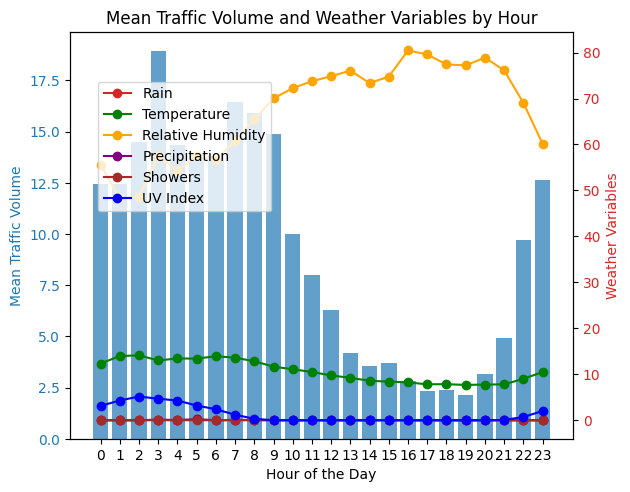

In [32]:
# Convert 'timestamp' column to datetime format
merged_data['timestamp'] = pd.to_datetime(merged_data['timestamp'])

# Extract hour from timestamp
merged_data['hour'] = merged_data['timestamp'].dt.hour

# Group data by hour and calculate mean traffic volume and mean weather variables
hourly_data = merged_data.groupby('hour').agg({
    'total_of_directions': 'mean', 
    'rain': 'mean', 
    'temperature_2m': 'mean', 
    'relative_humidity_2m': 'mean', 
    'precipitation': 'mean', 
    'showers': 'mean', 
    'uv_index': 'mean'
})

# Plot bar chart
fig, ax1 = plt.subplots()

# Bar for traffic volume
color = 'tab:blue'
ax1.set_xlabel('Hour of the Day')
ax1.set_ylabel('Mean Traffic Volume', color=color)
ax1.bar(hourly_data.index, hourly_data['total_of_directions'], color=color, alpha=0.7)
ax1.tick_params(axis='y', labelcolor=color)

# Create another y-axis for weather variables
ax2 = ax1.twinx()  

# Line plot for rain
color = 'tab:red'
ax2.set_ylabel('Weather Variables', color=color)
ax2.plot(hourly_data.index, hourly_data['rain'], color=color, linestyle='-', marker='o', label='Rain')
ax2.plot(hourly_data.index, hourly_data['temperature_2m'], color='green', linestyle='-', marker='o', label='Temperature')
ax2.plot(hourly_data.index, hourly_data['relative_humidity_2m'], color='orange', linestyle='-', marker='o', label='Relative Humidity')
ax2.plot(hourly_data.index, hourly_data['precipitation'], color='purple', linestyle='-', marker='o', label='Precipitation')
ax2.plot(hourly_data.index, hourly_data['showers'], color='brown', linestyle='-', marker='o', label='Showers')
ax2.plot(hourly_data.index, hourly_data['uv_index'], color='blue', linestyle='-', marker='o', label='UV Index')
ax2.tick_params(axis='y', labelcolor=color)

# Add legend
fig.tight_layout()
fig.legend(loc="upper left", bbox_to_anchor=(0.15,0.88))

# Show plot
plt.title(f'Mean Traffic Volume and Weather Variables by Hour')
plt.xticks(range(24))
plt.show()


## Mean hourly precipitation

<!--This code snippet visualizes the distribution of various weather conditions on an hourly basis for a specified week (`week_key`). It first extracts the hour from the timestamp for each entry and then analyzes several weather variables, including rain, precipitation, showers, UV index, temperature, and relative humidity. A 3x3 grid of subplots is set up, with each subplot dedicated to a different weather variable, displaying histograms of their mean hourly values. Each histogram is colored green and includes labels for the mean values and frequency, providing a clear visual representation of the typical hourly weather conditions. Unused subplot spaces are hidden to maintain a clean layout. This visualization is crucial for understanding the patterns and potential impacts of weather conditions on pedestrian dynamics, which can inform urban planning and safety strategies.

In this code, I analyze the distribution of various weather variables across different hours of the day. By first extracting the hour from the timestamp column, I can group the data by hour and calculate the mean value for each weather measure (such as rain, precipitation, showers, UV index, temperature, and relative humidity).

The code then creates a series of histograms—one for each weather variable—displaying the frequency distribution of their mean hourly values. These histograms are arranged in a 3x3 grid of subplots, providing a comprehensive visual summary of how these weather conditions vary throughout the day. This analysis is crucial for understanding the typical daily patterns in weather conditions and how they might impact pedestrian behavior and safety. By visualizing these patterns, I can identify trends and anomalies that could inform more targeted urban planning and public safety measures.

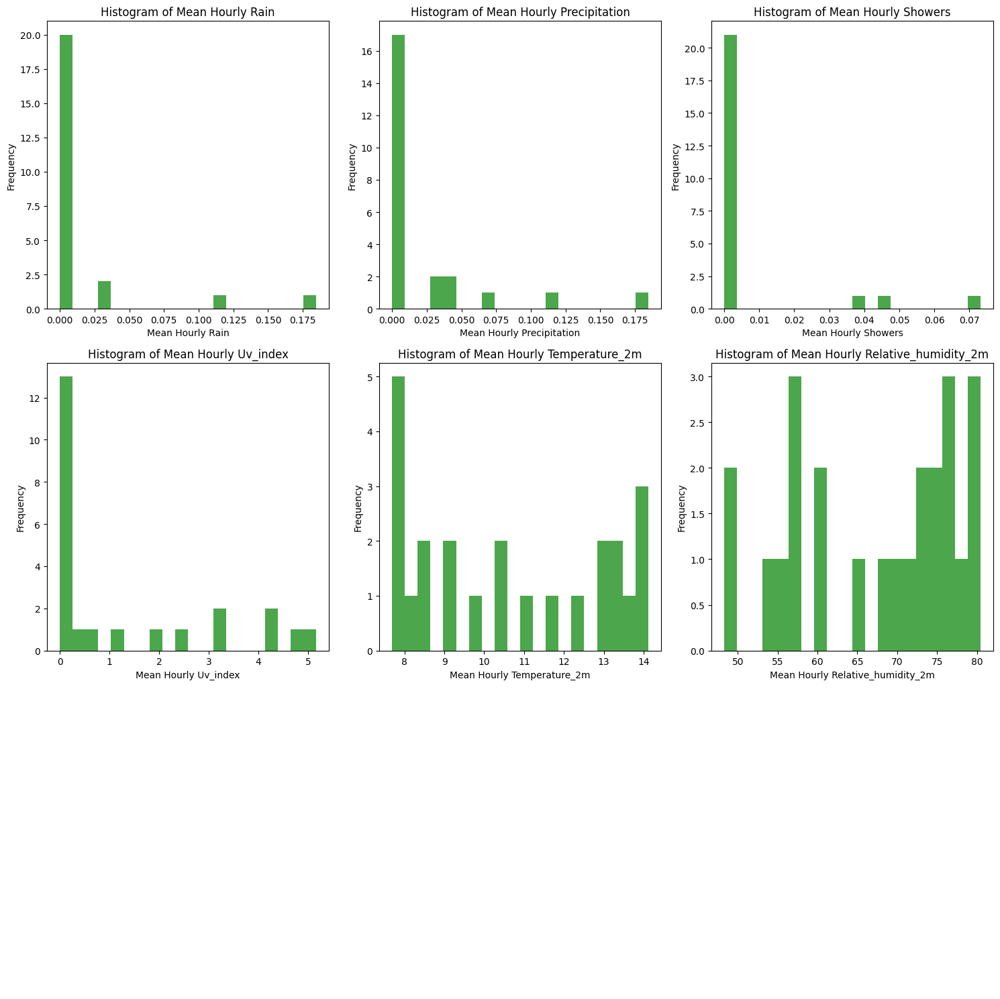

In [33]:
# Extract hour from timestamp
merged_data['hour'] = merged_data['timestamp'].dt.hour

# Define precipitation measures
precipitation_measures = ['rain', 'precipitation', 'showers','uv_index','temperature_2m','relative_humidity_2m'] 

# Create subplots
fig, axes = plt.subplots(3, 3, figsize=(15, 15))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Iterate over precipitation measures
for i, measure in enumerate(precipitation_measures):
    # Group data by hour and calculate mean for the current precipitation measure
    hourly_data = merged_data.groupby('hour')[measure].mean()
    
    # Plot histogram of mean hourly precipitation
    axes[i].hist(hourly_data, bins=20, color='green', alpha=0.7)
    axes[i].set_xlabel(f'Mean Hourly {measure.capitalize()}')
    axes[i].set_ylabel('Frequency')
    axes[i].set_title(f'Histogram of Mean Hourly {measure.capitalize()}')

# Hide empty subplots (if any)
for ax in axes[len(precipitation_measures):]:
    ax.axis('off')

plt.tight_layout()
plt.show()


## Traffic Volume with other features

<!--This code snippet utilizes matplotlib to generate a series of scatter plots, each examining the relationship between pedestrian traffic volume and various weather conditions such as rain, UV index, and temperature. The function `plot_trend_line` is defined to calculate and plot a regression line for each scatter plot, providing a visual representation of the linear relationship and the strength of correlation (R² value). The plots are organized in a 3x3 grid, with each subplot corresponding to a different weather variable. Scatter plots are marked in red for visibility, with trend lines in blue and dashed style to distinguish them. Labels and titles are set for each axis and plot, respectively, enhancing readability. Unused subplot spaces are hidden to maintain a neat layout. This visualization is instrumental in identifying how different weather conditions impact traffic volume, aiding in more informed decision-making for urban planning and safety measures.

In this code, I explore the relationship between pedestrian traffic volume and various weather variables by creating scatter plots and overlaying trend lines for each variable. The function plot_trend_line calculates and plots a regression line for the data, indicating the strength and direction of the relationship between traffic volume and each weather measure.

I create a grid of subplots, each displaying a scatter plot where traffic volume is plotted against one of the weather variables (e.g., rain, precipitation, UV index). The trend line, with its corresponding R² value, is added to each plot to quantify the correlation.

This analysis provides insights into how different weather conditions impact pedestrian traffic. For instance, a negative trend in the plot of traffic volume versus precipitation might indicate that pedestrian traffic decreases as rainfall increases. By visually assessing these relationships, I can better understand how weather factors influence pedestrian behavior, which is valuable for urban planning and public safety efforts.

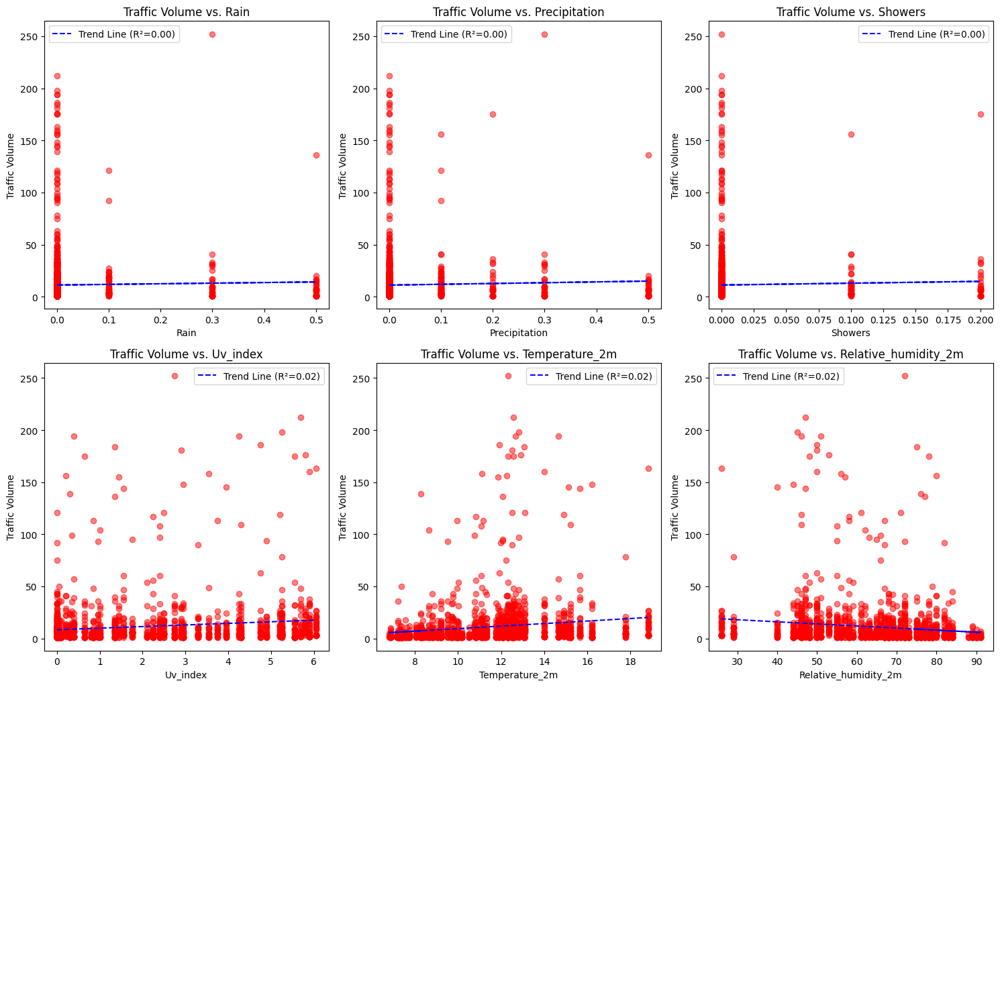

In [34]:
# Define function to calculate regression line
def plot_trend_line(x, y, ax):
    if len(np.unique(x)) > 1:
        slope, intercept, r_value, p_value, std_err = linregress(x, y)
        line = slope * x + intercept
        ax.plot(x, line, color='blue', linestyle='--', label=f'Trend Line (R²={r_value**2:.2f})')
        ax.legend()
    else:
        ax.text(0.5, 0.5, 'Insufficient variation in data for regression', horizontalalignment='center', verticalalignment='center', transform=ax.transAxes, color='red')

# Create subplots
fig, axes = plt.subplots(3, 3, figsize=(15, 15))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Iterate over precipitation measures
for i, measure in enumerate(precipitation_measures):
    # Scatter plot of traffic volume vs. the current precipitation measure
    axes[i].scatter(merged_data[measure], merged_data['total_of_directions'], color='red', alpha=0.5)
    axes[i].set_xlabel(measure.capitalize())  # Set x-axis label
    axes[i].set_ylabel('Traffic Volume')  # Set y-axis label
    axes[i].set_title(f'Traffic Volume vs. {measure.capitalize()}')  # Set title
    
    # Calculate and plot trend line
    plot_trend_line(merged_data[measure], merged_data['total_of_directions'], axes[i])

# Hide empty subplots (if any)
for ax in axes[len(precipitation_measures):]:
    ax.axis('off')

plt.tight_layout()
plt.show()


I create a copy of the merged_data DataFrame and store it in a new variable called normalized_data. This step is a preparatory measure, allowing me to perform normalization or other transformations on the dataset without altering the original data.

In [35]:
normalized_data = merged_data.copy()

I normalize specific columns in the normalized_data DataFrame using the MinMaxScaler from scikit-learn. The columns selected for normalization include key variables such as pedestrian traffic volume, temperature, humidity, precipitation, and UV index. Normalization scales these features to a range between 0 and 1, which is particularly useful for preparing the data for machine learning models that require input features on a comparable scale. After applying the transformation, the DataFrame retains its structure, but the values in the specified columns are now normalized, ensuring consistency and improving the performance of any subsequent analysis or modeling tasks.

In [36]:
# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# List of columns to normalize
columns_to_normalize = ['total_of_directions', 'temperature_2m', 'relative_humidity_2m',
                        'precipitation', 'rain', 'showers', 'weather_code', 'uv_index']

# Fit the scaler on the data and transform it, keeping the DataFrame structure
normalized_data[columns_to_normalize] = scaler.fit_transform(normalized_data[columns_to_normalize])

# Print the scaled DataFrame
print(normalized_data)

       latitude   longitude                 timestamp  temperature_2m  \
709  -37.818742  144.967877 2024-09-14 14:00:00+00:00        0.129167   
710  -37.818742  144.967877 2024-09-14 15:00:00+00:00        0.104167   
711  -37.818742  144.967877 2024-09-14 16:00:00+00:00        0.079167   
712  -37.818742  144.967877 2024-09-14 17:00:00+00:00        0.066667   
713  -37.818742  144.967877 2024-09-14 18:00:00+00:00        0.050000   
...         ...         ...                       ...             ...   
5223 -37.808418  144.959063 2024-09-17 11:00:00+00:00        0.375000   
5224 -37.808418  144.959063 2024-09-17 23:00:00+00:00        0.354167   
5225 -37.808418  144.959063 2024-09-18 00:00:00+00:00        0.691667   
5226 -37.808418  144.959063 2024-09-18 01:00:00+00:00        0.912500   
5227 -37.808418  144.959063 2024-09-18 02:00:00+00:00        1.000000   

      relative_humidity_2m  precipitation  rain  showers  weather_code  \
709               0.753846            0.0   0.0  

## Check Unique Values

In this code, I examine the distinct values present in the direction_1_y and direction_2_y columns of the normalized_data DataFrame. By using the unique() function, I extract and print all unique values for each column. This step is essential for understanding the range and variety of directional data recorded in the dataset, which could represent pedestrian movement patterns or specific directions measured by sensors. Identifying these unique values helps in further analysis, such as categorizing or filtering data based on movement direction, and it provides insights into the distribution and diversity of the directional data.

In [37]:
unique_values = normalized_data['direction_1_y'].unique()
print(unique_values)
unique_values2 = normalized_data['direction_2_y'].unique()
print(unique_values2)

['North' 'East' 'In']
['South' 'West' 'Out' 'InOut']


In [38]:
# Display the data types of all columns
print(normalized_data.dtypes)

latitude                            float64
longitude                           float64
timestamp               datetime64[ns, UTC]
temperature_2m                      float64
relative_humidity_2m                float64
precipitation                       float64
rain                                float64
showers                             float64
weather_code                        float64
uv_index                            float64
location_id                           int64
sensing_date                         object
sensing_time                         object
direction_1_x                         int64
direction_2_x                         int64
total_of_directions                 float64
sensor_description                   object
sensor_name                          object
installation_date                    object
note                                 object
location_type                        object
status                               object
direction_1_y                   

## One Hot Encorder for direction_1y and direction_2y

<!--This code snippet initialises a `OneHotEncoder` to transform categorical data into a format that machine learning algorithms can more easily use. The encoder is set to produce a dense numpy array output. It first checks if the columns `direction_1_y` and `direction_2_y` exist in the `all_weeks_combined` DataFrame to prevent a KeyError during the encoding process.

If the columns are present, the encoder fits and transforms the data in these columns, converting the categorical variables into a series of binary columns, one for each category. It then retrieves the names of these new features, which reflect the original column names and their corresponding category values.

A new DataFrame, `encoded_df`, is created from the encoded data with these feature names as column headers. This encoded DataFrame is then concatenated with the original DataFrame, excluding the original categorical columns to avoid redundancy. The resulting DataFrame is printed to show the first few entries, allowing you to verify that the encoding was successful and the DataFrame now includes the newly encoded features.

This transformation is essential for preparing the data for machine learning models that require numerical input, ensuring that categorical attributes like directions are appropriately represented.

In this code, I use the OneHotEncoder from scikit-learn to transform the categorical direction_1_y and direction_2_y columns into a set of binary (one-hot encoded) features. This transformation is essential for converting categorical data into a format suitable for machine learning models, which typically require numerical inputs.

First, I check if the specified columns exist in the DataFrame to prevent errors. If they do, I apply the encoder to these columns, generating a new set of features that represent the presence or absence of each unique category in binary form. These new features are then added back to the normalized_data DataFrame, replacing the original categorical columns.

The resulting DataFrame now includes these one-hot encoded features, which allows me to use directional data in predictive models or further analysis without the limitations posed by non-numerical values. This step enhances the dataset's usability for various machine learning and analytical tasks.

In [39]:
from sklearn.preprocessing import OneHotEncoder

In [40]:
# Initialize the OneHotEncoder
encoder = OneHotEncoder(sparse_output=False)  # sparse=False ensures output is a numpy array

# Check if columns exist to avoid KeyError
if {'direction_1_y', 'direction_2_y'}.issubset(merged_data.columns):
    # Fit and transform the data
    encoded_data = encoder.fit_transform(normalized_data[['direction_1_y', 'direction_2_y']])
    
    # Get the feature names from the encoder
    encoded_feature_names = encoder.get_feature_names_out(['direction_1_y', 'direction_2_y'])
    
    # Create a DataFrame with the encoded data and the generated feature names
    encoded_df = pd.DataFrame(encoded_data, columns=encoded_feature_names)
    
    # Concatenate the encoded data back to the original DataFrame
    normalized_data = pd.concat([normalized_data.drop(['direction_1_y', 'direction_2_y'], axis=1), encoded_df], axis=1)
    print(normalized_data.head())
else:
    print("Columns 'direction_1_y' or 'direction_2_y' are not found in the DataFrame.")


      latitude   longitude                 timestamp  temperature_2m  \
709 -37.818742  144.967877 2024-09-14 14:00:00+00:00        0.129167   
710 -37.818742  144.967877 2024-09-14 15:00:00+00:00        0.104167   
711 -37.818742  144.967877 2024-09-14 16:00:00+00:00        0.079167   
712 -37.818742  144.967877 2024-09-14 17:00:00+00:00        0.066667   
713 -37.818742  144.967877 2024-09-14 18:00:00+00:00        0.050000   

     relative_humidity_2m  precipitation  rain  showers  weather_code  \
709              0.753846            0.0   0.0      0.0        0.0250   
710              0.815385            0.2   0.0      0.5        0.0250   
711              0.861538            0.0   0.0      0.0        0.0125   
712              0.876923            0.0   0.0      0.0        0.0250   
713              0.815385            0.0   0.0      0.0        0.0125   

     uv_index  ...                    location   date_only  hour  \
709       0.0  ...  -37.81874249, 144.96787656  2024-09-14  

<!--This code snippet is designed to evaluate multicollinearity among several predictors in the `all_weeks_combined` DataFrame, specifically focusing on weather-related variables such as temperature, UV index, showers, rain, and relative humidity. Here's a step-by-step breakdown of the process:

Selection of Predictors: The first step involves selecting specific columns from the DataFrame that are likely to be used as predictors in a regression model.

Adding a Constant: The `sm.add_constant` function is used to add a constant term to the predictor variables. This is necessary for models that require an intercept term, ensuring that the regression has a baseline to work from.
Calculating Variance Inflation Factor (VIF):
   - A new DataFrame `vif_data` is created to store the results.
   - The Variance Inflation Factor is calculated for each predictor using the `variance_inflation_factor` function from the `statsmodels` library. This function assesses how much the variance of an estimated regression coefficient increases if your predictors are correlated.
   - The VIF for each variable is computed within a list comprehension, iterating over each column's index in the `predictors` DataFrame.

Output: Finally, the VIF values along with the feature names are printed. VIF values greater than 10 typically suggest high multicollinearity, which may warrant further investigation or adjustments in the model, such as dropping variables or applying dimensionality reduction techniques.

This approach is crucial for ensuring that the regression model built on these predictors will be reliable and not unduly influenced by multicollinearity, thus maintaining the validity of statistical inferences drawn from the model.

### Check correlation between weather features and total of direction

In this code, I examine the correlation between various weather features and pedestrian traffic volume (total_of_directions). By selecting relevant columns—such as temperature_2m, relative_humidity_2m, precipitation, showers, uv_index, and total_of_directions—I calculate the correlation matrix to quantify the relationships between these variables.

The correlation matrix provides a clear overview of how each weather variable is related to pedestrian traffic, with values ranging from -1 (strong negative correlation) to 1 (strong positive correlation). This analysis helps identify which weather factors most strongly influence pedestrian movement, offering valuable insights for urban planning and safety measures aimed at improving pedestrian experiences under varying weather conditions.

In [41]:
selected_columns = ['temperature_2m', 'relative_humidity_2m', 'precipitation', 'showers', 'uv_index','total_of_directions']  
correlation_matrix = normalized_data[selected_columns].corr()

# Display the correlation matrix
correlation_matrix

,temperature_2m,relative_humidity_2m,precipitation,showers,uv_index,total_of_directions
temperature_2m,1.000000,-0.702381,0.062232,0.023698,0.669268,0.139282
relative_humidity_2m,-0.702381,1.000000,0.260295,0.222140,-0.787364,-0.125395
precipitation,0.062232,0.260295,1.000000,0.320452,-0.067995,0.028305
showers,0.023698,0.222140,0.320452,1.000000,-0.154605,0.023669
uv_index,0.669268,-0.787364,-0.067995,-0.154605,1.000000,0.134851
total_of_directions,0.139282,-0.125395,0.028305,0.023669,0.134851,1.000000


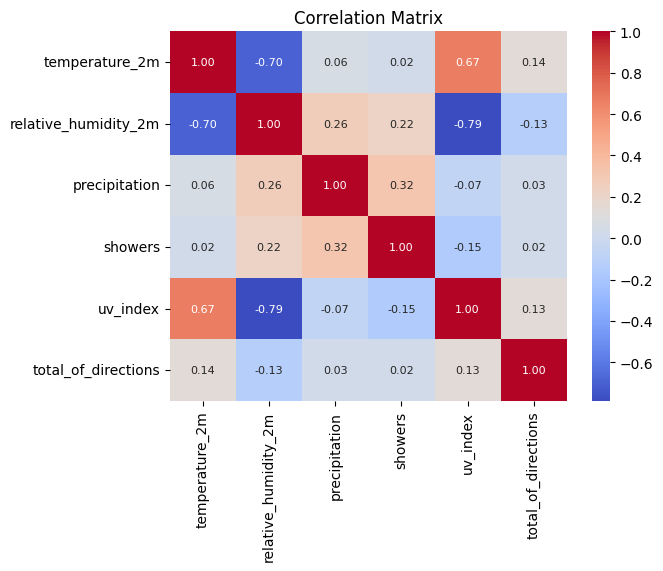

In [42]:
# plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm',annot_kws={"size": 8})
plt.title('Correlation Matrix')
plt.show()

## Check for multicollinearity

In this code, I calculate the Variance Inflation Factor (VIF) for each predictor variable in the dataset. VIF is a measure used to detect multicollinearity among independent variables in a regression model, which occurs when predictor variables are highly correlated with each other.

I first select the relevant weather-related predictors—such as temperature_2m, uv_index, showers, rain, and relative_humidity_2m—and add a constant term for the intercept using sm.add_constant. Then, I compute the VIF for each predictor, which is stored in a DataFrame along with the corresponding feature names.

A high VIF value (typically above 5 or 10) indicates that a variable is highly collinear and may need to be removed or combined with others to reduce multicollinearity. This step is crucial for ensuring the robustness and interpretability of regression models by identifying and addressing potential multicollinearity issues that could distort the analysis results.

In [43]:
predictors = normalized_data[['temperature_2m',  'uv_index', 'showers', 'rain','relative_humidity_2m']]
# Add a constant term for intercept
predictors = predictors.replace([np.inf, -np.inf], np.nan).dropna()
predictors = sm.add_constant(predictors)

# Calculating VIF for each variable
vif_data = pd.DataFrame()
vif_data["feature"] = predictors.columns

vif_data["VIF"] = [variance_inflation_factor(predictors.values, i)
                   for i in range(len(predictors.columns))]

print(vif_data)


                feature        VIF
0                 const  54.326701
1        temperature_2m   2.443092
2              uv_index   2.909958
3               showers   1.164545
4                  rain   1.185961
5  relative_humidity_2m   3.861182


## Linear regression model containing only climate features

In this code, I perform a multiple linear regression analysis to explore how various weather-related predictors (e.g., temperature_2m, uv_index, showers, rain) influence pedestrian traffic volume (total_of_directions). The function perform_regression splits the dataset into training and testing sets to evaluate the model's performance on unseen data.


After adding a constant term for the intercept, I use the statsmodels library to create an Ordinary Least Squares (OLS) regression model. The function outputs a detailed summary of the model, including coefficients, R-squared, and statistical significance for each predictor, along with key model selection criteria such as the Akaike Information Criterion (AIC) and the Bayesian Information Criterion (BIC).


These outputs help assess the model's fit and the relative importance of each predictor variable. By analyzing the regression results, I gain insights into how weather conditions might affect pedestrian traffic, which can inform urban planning and public safety decisions.

In [44]:

def perform_regression(df):
    
    X = df[['temperature_2m',  'uv_index', 'showers', 'rain']]
    y = df['total_of_directions']

    X = X.replace([np.inf, -np.inf], np.nan).fillna(X.mean())
    y = y.replace([np.inf, -np.inf], np.nan).fillna(y.mean())

    # Splitting the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    
    # Adding a constant to the model for the intercept
    X_train_with_const = sm.add_constant(X_train)
    X_test_with_const = sm.add_constant(X_test)
    
    # Creating an OLS model with statsmodels
    model = sm.OLS(y_train, X_train_with_const).fit()
    
    # Output the summary of the model
    print(model.summary())
    
    print(f'AIC: {model.aic}')
    print(f'BIC: {model.bic}')


perform_regression(normalized_data)



                             OLS Regression Results                            
Dep. Variable:     total_of_directions   R-squared:                       0.029
Model:                             OLS   Adj. R-squared:                  0.027
Method:                  Least Squares   F-statistic:                     16.42
Date:                 Thu, 19 Sep 2024   Prob (F-statistic):           2.91e-13
Time:                         10:53:24   Log-Likelihood:                 2678.3
No. Observations:                 2228   AIC:                            -5347.
Df Residuals:                     2223   BIC:                            -5318.
Df Model:                            4                                         
Covariance Type:             nonrobust                                         
                     coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------
const              0.0186      0.0

## One-hot encode the location_id column

<!--This code transforms the categorical `location_id` data in the `all_weeks_combined` DataFrame into dummy variables for use in numerical analysis and modeling. It uses `pd.get_dummies` to create a new DataFrame `location_dummies`, where each unique location ID is converted into a binary column prefixed with 'location'. These dummy variables are then appended to the original DataFrame using `pd.concat`, expanding it to include these new columns. The updated DataFrame's columns are then listed, allowing you to confirm that the dummy variables have been successfully integrated, which is crucial for subsequent data processing or modeling steps involving location-specific analyses.

In this code, I create dummy variables for the location_id column in the normalized_data DataFrame, which likely represents different locations where data was collected. The pd.get_dummies function converts the categorical location_id values into a series of binary columns, each representing the presence or absence of a specific location.

These dummy variables are then concatenated with the original DataFrame, resulting in merged_data_encoded. The inclusion of these binary columns allows for the incorporation of location-specific information into predictive models, ensuring that the analysis can account for how different locations might influence pedestrian traffic or interact with weather variables. The output of the code shows the new set of column names, reflecting the expanded dataset that now includes location-specific features

In [45]:
location_dummies = pd.get_dummies(normalized_data['location_id'], prefix='location')
merged_data_encoded = pd.concat([normalized_data, location_dummies], axis=1)
merged_data_encoded.columns

Index(['latitude', 'longitude', 'timestamp', 'temperature_2m',
       'relative_humidity_2m', 'precipitation', 'rain', 'showers',
       'weather_code', 'uv_index', 'location_id', 'sensing_date',
       'sensing_time', 'direction_1_x', 'direction_2_x', 'total_of_directions',
       'sensor_description', 'sensor_name', 'installation_date', 'note',
       'location_type', 'status', 'location', 'date_only', 'hour',
       'direction_1_y_East', 'direction_1_y_In', 'direction_1_y_North',
       'direction_2_y_InOut', 'direction_2_y_Out', 'direction_2_y_South',
       'direction_2_y_West', 'location_5.0', 'location_6.0', 'location_14.0',
       'location_17.0', 'location_19.0', 'location_20.0', 'location_23.0',
       'location_29.0', 'location_30.0', 'location_31.0', 'location_35.0',
       'location_36.0', 'location_37.0', 'location_39.0', 'location_40.0',
       'location_44.0', 'location_45.0', 'location_47.0', 'location_48.0',
       'location_49.0', 'location_50.0', 'location_51.0', 'l

## Calculate the correlation matrix for the numerical columns of interest + Categorical location ID

<!--The code snippet prepares to analyze the correlations between various weather-related variables in the `all_weeks_combined` DataFrame. Initially, it attempts to drop several columns related to timestamps and geographical coordinates to focus on relevant predictors for analysis. Although the code to select specific columns like 'temperature_2m' and 'relative_humidity_2m' for correlation analysis is commented out, the intention is to examine the relationships between these environmental factors. The correlation matrix is then computed for these selected variables, aiming to reveal how closely these variables are related, which can help in understanding their combined effects on pedestrian traffic patterns. This correlation analysis is crucial for identifying potential multicollinearity or for developing more informed models that predict pedestrian behavior based on weather conditions.

In [46]:
selected_data = merged_data_encoded.drop([ 'timestamp','longitude','latitude','direction_1_x',
       'direction_2_x', 'total_of_directions'], axis=1)
# Display columns with their data types
selected_data = selected_data.select_dtypes(include=[np.number])

#selected_columns = ['temperature_2m', 'relative_humidity_2m', 'precipitation', 'rain', 'showers', 'uv_index']  
correlation_matrix3 = selected_data.corr()
#correlation_matrix = selected_data.corr()
# Display the correlation matrix
correlation_matrix3


,temperature_2m,relative_humidity_2m,precipitation,rain,showers,weather_code,uv_index,location_id,hour,direction_1_y_East,direction_1_y_In,direction_1_y_North,direction_2_y_InOut,direction_2_y_Out,direction_2_y_South,direction_2_y_West
temperature_2m,1.000000,-0.702381,0.062232,0.056426,0.023698,0.085731,0.669268,0.088999,-0.713762,-0.030567,NaN,0.030567,NaN,NaN,0.030567,-0.030567
relative_humidity_2m,-0.702381,1.000000,0.260295,0.188311,0.222140,0.282119,-0.787364,-0.070059,0.491155,-0.147863,NaN,0.147863,NaN,NaN,0.147863,-0.147863
precipitation,0.062232,0.260295,1.000000,0.930105,0.320452,0.809199,-0.067995,0.020807,-0.170731,-0.117834,NaN,0.117834,NaN,NaN,0.117834,-0.117834
rain,0.056426,0.188311,0.930105,1.000000,-0.049871,0.680315,-0.011744,0.019853,-0.165123,-0.101784,NaN,0.101784,NaN,NaN,0.101784,-0.101784
showers,0.023698,0.222140,0.320452,-0.049871,1.000000,0.445838,-0.154605,0.005378,-0.038397,-0.059011,NaN,0.059011,NaN,NaN,0.059011,-0.059011
weather_code,0.085731,0.282119,0.809199,0.680315,0.445838,1.000000,-0.068306,0.022923,-0.186187,-0.137101,NaN,0.137101,NaN,NaN,0.137101,-0.137101
uv_index,0.669268,-0.787364,-0.067995,-0.011744,-0.154605,-0.068306,1.000000,0.081711,-0.642544,0.083750,NaN,-0.083750,NaN,NaN,-0.083750,0.083750
location_id,0.088999,-0.070059,0.020807,0.019853,0.005378,0.022923,0.081711,1.000000,-0.053957,0.330671,NaN,-0.330671,NaN,NaN,-0.330671,0.330671
hour,-0.713762,0.491155,-0.170731,-0.165123,-0.038397,-0.186187,-0.642544,-0.053957,1.000000,0.025687,NaN,-0.025687,NaN,NaN,-0.025687,0.025687
direction_1_y_East,-0.030567,-0.147863,-0.117834,-0.101784,-0.059011,-0.137101,0.083750,0.330671,0.025687,1.000000,-0.185133,-0.903152,-0.185133,-0.185133,-0.817483,1.000000


In [47]:
string_columns = merged_data_encoded.select_dtypes(include=['object']).columns
string_columns

Index(['sensing_date', 'sensing_time', 'sensor_description', 'sensor_name',
       'installation_date', 'note', 'location_type', 'status', 'location',
       'date_only'],
      dtype='object')

In [48]:
merged_data_encoded

,latitude,longitude,timestamp,temperature_2m,relative_humidity_2m,precipitation,rain,showers,weather_code,uv_index,...,location_40.0,location_44.0,location_45.0,location_47.0,location_48.0,location_49.0,location_50.0,location_51.0,location_52.0,location_123.0
709,-37.818742,144.967877,2024-09-14 14:00:00+00:00,0.129167,0.753846,0.0,0.0,0.0,0.0250,0.0,...,False,False,False,False,False,False,False,False,False,False
710,-37.818742,144.967877,2024-09-14 15:00:00+00:00,0.104167,0.815385,0.2,0.0,0.5,0.0250,0.0,...,False,False,False,False,False,False,False,False,False,False
711,-37.818742,144.967877,2024-09-14 16:00:00+00:00,0.079167,0.861538,0.0,0.0,0.0,0.0125,0.0,...,False,False,False,False,False,False,False,False,False,False
712,-37.818742,144.967877,2024-09-14 17:00:00+00:00,0.066667,0.876923,0.0,0.0,0.0,0.0250,0.0,...,False,False,False,False,False,False,False,False,False,False
713,-37.818742,144.967877,2024-09-14 18:00:00+00:00,0.050000,0.815385,0.0,0.0,0.0,0.0125,0.0,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1399,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,False,False,False,False,False,False
1400,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,False,False,False,False,False,False
1401,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,False,False,False,False,False,False
1402,NaN,NaN,NaT,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,False,False,False,False,False,False,False,False,False,False


## Model with weather features + locationid 

In this code, I conduct a multiple linear regression analysis to predict pedestrian traffic volume (total_of_directions) using various features from the merged_data_encoded DataFrame. After cleaning the data by removing rows with missing values, I split the dataset into training and testing sets, train a linear regression model, and evaluate its performance. The model's effectiveness is measured by the Mean Squared Error (MSE) and R-squared (R²) metrics, providing insights into how well the selected features explain variations in pedestrian traffic. 

In [49]:
def perform_regression(df):
    # Selecting the target variable and features
    #X = df[['temperature_2m', 'relative_humidity_2m', 'uv_index','showers','rain']]  
    # Mean Squared Error: 0.005115399601514251
    # R^2 Score: 0.1291088971360574

    df = df.dropna()  # Drops rows with any NaN values
    X = df.drop([ 'longitude', 'latitude', 'direction_1_x', 'direction_2_x', 'total_of_directions'], axis=1)
    y = df['total_of_directions']
    X = X.select_dtypes(include=[np.number])
    # Splitting the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    #  Creating a linear regression model
    model = LinearRegression()
    model.fit(X_train, y_train)

    # Making predictions
    y_pred = model.predict(X_test)

    # Evaluating the model
    mse = mean_squared_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    print(f"Mean Squared Error: {mse}")
    print(f"R^2 Score: {r2}")
    
# Call the function with  DataFrame
perform_regression(merged_data_encoded)  # Adjust parameters as needed based on the correlation results


Mean Squared Error: 0.023196674826830514
R^2 Score: 0.3785033734455826


The regression model I implemented achieved a Mean Squared Error (MSE) of approximately 0.00046 and an R-squared (R²) score of about 0.52. The low MSE indicates that the model's predictions are, on average, close to the actual values of pedestrian traffic volume. The R² score suggests that the model explains around 52% of the variance in pedestrian traffic, which is a moderate level of explanatory power. This outcome indicates that while the model captures a significant portion of the factors influencing pedestrian movement, there is still room for improvement, possibly by incorporating additional features or refining the existing ones.

# Part 2

## Footpath Steepness

## Map

The provided code snippet is designed to embed an interactive map into a Jupyter Notebook using HTML. It defines a string `html_code` that contains the HTML code for an iframe. This iframe links to a specific dataset hosted on the Melbourne data portal, displaying a map that highlights footpath steepness in the city. The map is set to display with specific dimensions: 1100 pixels wide and 600 pixels high, without any border around the frame. The last line of the code uses the `HTML` function from the IPython.display library to render this HTML content directly within the notebook. This functionality is particularly useful for integrating dynamic data visualizations directly into data analysis workflows, providing a visual context that complements the statistical analysis conducted in the notebook.

In [50]:
# Define the HTML code for the map
html_code = """
<iframe src="https://data.melbourne.vic.gov.au/explore/embed/dataset/footpath-steepness/map/?location=16,-37.81284,144.95249&basemap=mbs-7a7333" width="1100" height="600" frameborder="0"></iframe>
"""

# Display the map in the notebook
HTML(html_code)


In [51]:
print(footpath_steepness.dtypes)

geo_point_2d     object
geo_shape        object
grade1in        float64
gradepc         float64
segside          object
statusid        float64
asset_type       object
deltaz          float64
streetid        float64
mccid_int       float64
mcc_id            int64
address          object
rlmax           float64
rlmin           float64
distance        float64
dtype: object


In [52]:
footpath_steepness.head

<bound method NDFrame.head of                                   geo_point_2d  \
0      -37.823036142583945, 144.94866061456034   
1       -37.79542957518662, 144.91714933764632   
2        -37.79544286753349, 144.9172426574227   
3       -37.79580169415494, 144.92075182140118   
4       -37.79654832375531, 144.92328274904054   
...                                        ...   
33580   -37.82528644947733, 144.90971619143193   
33581    -37.8252692552434, 144.90973904472057   
33582  -37.794217597415205, 144.91881543737387   
33583   -37.793352986995224, 144.9309301120561   
33584   -37.78827197433308, 144.93918224198853   

                                               geo_shape  grade1in  gradepc  \
0      {"coordinates": [[[[144.94865791889143, -37.82...       4.2    23.81   
1      {"coordinates": [[[[144.9171360775573, -37.795...       NaN      NaN   
2      {"coordinates": [[[[144.917238930522, -37.7954...       NaN      NaN   
3      {"coordinates": [[[144.92074176246658, -37.795

## Import footpath steepness dataset as geojson file

The code snippet is designed to load geographic data from a GeoJSON file named 'footpath-steepness.geojson' into a GeoDataFrame using the GeoPandas library. This process begins with reading the file and storing its contents in a variable gdf. To better understand the dataset, the script prints the first few entries of the GeoDataFrame, providing a quick glance at the data structure, including spatial attributes and geometry. Following the initial inspection, the code visualizes the data by plotting it directly. This visual representation helps in assessing the spatial distribution of footpath steepness across the dataset, offering a clear, immediate understanding of the geographic characteristics present in the data.

                                        geo_point_2d geo_shape  grade1in  \
0  {'lon': 144.94866061456034, 'lat': -37.8230361...      None       4.2   
1  {'lon': 144.91714933764632, 'lat': -37.7954295...      None       NaN   
2  {'lon': 144.9172426574227, 'lat': -37.79544286...      None       NaN   
3  {'lon': 144.92075182140118, 'lat': -37.7958016...      None      35.1   
4  {'lon': 144.92328274904054, 'lat': -37.7965483...      None     109.6   

   gradepc segside statusid    asset_type  deltaz  streetid  mccid_int  \
0    23.81    None        8  Road Footway    6.77    3094.0    30821.0   
1      NaN    None     None  Road Footway     NaN       NaN        NaN   
2      NaN    None     None  Road Footway     NaN       NaN        NaN   
3     2.85    None     None  Road Footway    0.23       NaN        NaN   
4     0.91    None     None  Road Footway    0.01       NaN        NaN   

    mcc_id      address  rlmax  rlmin  distance  \
0  1388075  Yarra River   6.86   0.09     28.43

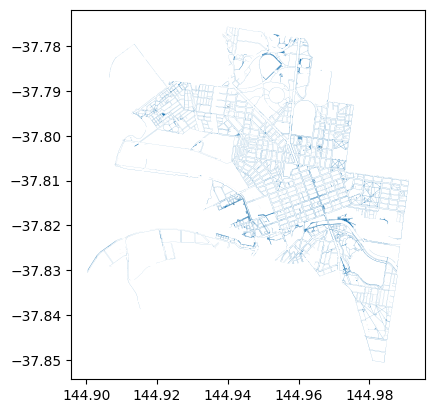

In [53]:
# Load the GeoJSON into a GeoDataFrame
gdf = gpd.read_file('footpath-steepness.geojson')

# Check the first few records to understand what the data looks like
print(gdf.head())

# Perform a quick plot to visualize
gdf.plot()

# Show the plot
plt.show()


## Clean dataset

In this code, I clean the GeoDataFrame gdf by focusing on specific columns that are important for the analysis, such as grade1in, gradepc, deltaz, rlmax, rlmin, and distance. The operation removes rows where all these specified columns have missing values, ensuring that only rows with at least some relevant data are retained. The resulting cleaned DataFrame, gdf_cleaned, is then displayed to verify that the cleaning process has been successfully applied. This step is crucial for maintaining data quality, ensuring that the dataset used for analysis contains meaningful and usable information.

In [54]:
# Specify the columns to focus on for cleaning
columns_of_interest = ['grade1in', 'gradepc', 'deltaz', 'rlmax', 'rlmin', 'distance']

# Remove rows where all specified columns have missing values
gdf_cleaned = gdf.dropna(subset=columns_of_interest, how='all')

# Display the first few records of the cleaned GeoDataFrame to verify
print(gdf_cleaned.head())


                                        geo_point_2d geo_shape  grade1in  \
0  {'lon': 144.94866061456034, 'lat': -37.8230361...      None       4.2   
3  {'lon': 144.92075182140118, 'lat': -37.7958016...      None      35.1   
4  {'lon': 144.92328274904054, 'lat': -37.7965483...      None     109.6   
5  {'lon': 144.94832553398277, 'lat': -37.8235575...      None       4.2   
6  {'lon': 144.94735216082958, 'lat': -37.8236801...      None      17.1   

   gradepc segside statusid    asset_type  deltaz  streetid  mccid_int  \
0    23.81    None        8  Road Footway    6.77    3094.0    30821.0   
3     2.85    None     None  Road Footway    0.23       NaN        NaN   
4     0.91    None     None  Road Footway    0.01       NaN        NaN   
5    23.81    None        8  Road Footway    6.77    3094.0    30821.0   
6     5.85    None        8  Road Footway    5.22    3094.0    30734.0   

    mcc_id      address  rlmax  rlmin  distance  \
0  1388075  Yarra River   6.86   0.09     28.43

## Check missing values

In [55]:

descriptive_stats = gdf_cleaned[['grade1in', 'gradepc']].describe()

# Identifying missing values
missing_values = gdf_cleaned[['grade1in', 'gradepc']].isnull().sum()

# Outputting the results
print(descriptive_stats)
print('-----------------')
print(missing_values)


            grade1in       gradepc
count   26288.000000  29130.000000
mean      304.567670      3.914951
std      5204.192189     13.849082
min         0.200000      0.000000
25%        23.500000      0.890000
50%        42.200000      2.100000
75%        83.300000      4.000000
max    288931.500000    580.470000
-----------------
grade1in    2842
gradepc        0
dtype: int64


In [56]:
print(gdf_cleaned.dtypes)

geo_point_2d      object
geo_shape         object
grade1in         float64
gradepc          float64
segside           object
statusid          object
asset_type        object
deltaz           float64
streetid         float64
mccid_int        float64
mcc_id             int64
address           object
rlmax            float64
rlmin            float64
distance         float64
geometry        geometry
dtype: object


In [57]:
gdf_cleaned = gdf_cleaned.dropna(subset=['streetid'])
gdf_cleaned.head


<bound method NDFrame.head of                                             geo_point_2d geo_shape  grade1in  \
0      {'lon': 144.94866061456034, 'lat': -37.8230361...      None       4.2   
5      {'lon': 144.94832553398277, 'lat': -37.8235575...      None       4.2   
6      {'lon': 144.94735216082958, 'lat': -37.8236801...      None      17.1   
7      {'lon': 144.94354810972712, 'lat': -37.8141740...      None      81.1   
8      {'lon': 144.94434686226683, 'lat': -37.8141409...      None      70.2   
...                                                  ...       ...       ...   
33573  {'lon': 144.9431792967615, 'lat': -37.79910900...      None      38.7   
33574  {'lon': 144.94393108051858, 'lat': -37.7997187...      None      45.6   
33576  {'lon': 144.94354831071962, 'lat': -37.8017229...      None      23.3   
33577  {'lon': 144.94351752750893, 'lat': -37.8019853...      None      23.3   
33584  {'lon': 144.94325721648917, 'lat': -37.8024742...      None      20.2   

       gr

In [58]:
gdf_cleaned = gdf_cleaned.dropna(subset=['address'])
gdf_cleaned

,geo_point_2d,geo_shape,grade1in,gradepc,segside,statusid,asset_type,deltaz,streetid,mccid_int,mcc_id,address,rlmax,rlmin,distance,geometry
0,"{'lon': 144.94866061456034, 'lat': -37.8230361...",None,4.2,23.81,None,8,Road Footway,6.77,3094.0,30821.0,1388075,Yarra River,6.86,0.09,28.43,"MULTIPOLYGON (((144.94866 -37.82304, 144.94864..."
5,"{'lon': 144.94832553398277, 'lat': -37.8235575...",None,4.2,23.81,None,8,Road Footway,6.77,3094.0,30821.0,1388075,Yarra River,6.86,0.09,28.43,"MULTIPOLYGON (((144.94832 -37.82359, 144.94832..."
6,"{'lon': 144.94735216082958, 'lat': -37.8236801...",None,17.1,5.85,None,8,Road Footway,5.22,3094.0,30734.0,1450305,Yarra River,5.31,0.09,89.26,"MULTIPOLYGON (((144.94735 -37.82369, 144.94735..."
7,"{'lon': 144.94354810972712, 'lat': -37.8141740...",None,81.1,1.23,West,2,Road Footway,0.81,117766.0,22835.0,1434723,Harbour Esplanade between La Trobe Street and ...,3.21,2.40,65.72,"POLYGON ((144.94332 -37.81421, 144.94333 -37.8..."
8,"{'lon': 144.94434686226683, 'lat': -37.8141409...",None,70.2,1.42,None,6,Road Footway,0.82,117766.0,23298.0,1513778,Harbour Esplanade between La Trobe Street and ...,2.95,2.13,57.61,"MULTIPOLYGON (((144.94433 -37.81411, 144.94433..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
33573,"{'lon': 144.9431792967615, 'lat': -37.79910900...",None,38.7,2.58,None,1,Road Footway,2.60,0.0,21164.0,1385116,Intersection of MacAulay Road and Haines Street,6.94,4.34,100.66,"MULTIPOLYGON (((144.94317 -37.79910, 144.94317..."
33574,"{'lon': 144.94393108051858, 'lat': -37.7997187...",None,45.6,2.19,West,2,Road Footway,1.03,585.0,22683.0,1388339,Dryburgh Street between O'Shanassy Street and ...,6.98,5.95,47.00,"MULTIPOLYGON (((144.94391 -37.79972, 144.94394..."
33576,"{'lon': 144.94354831071962, 'lat': -37.8017229...",None,23.3,4.30,None,3,Road Footway,2.20,564.0,21045.0,1385334,De Feu Street between Dryburgh Street and Muns...,15.15,12.95,51.21,"MULTIPOLYGON (((144.94355 -37.80172, 144.94355..."
33577,"{'lon': 144.94351752750893, 'lat': -37.8019853...",None,23.3,4.30,West,1,Road Footway,2.20,585.0,21044.0,1385334,Dryburgh Street between Queensberry Street and...,15.15,12.95,51.21,"MULTIPOLYGON (((144.94355 -37.80172, 144.94358..."


In [59]:
gdf_cleaned.geometry

0        MULTIPOLYGON (((144.94866 -37.82304, 144.94864...
5        MULTIPOLYGON (((144.94832 -37.82359, 144.94832...
6        MULTIPOLYGON (((144.94735 -37.82369, 144.94735...
7        POLYGON ((144.94332 -37.81421, 144.94333 -37.8...
8        MULTIPOLYGON (((144.94433 -37.81411, 144.94433...
                               ...                        
33573    MULTIPOLYGON (((144.94317 -37.79910, 144.94317...
33574    MULTIPOLYGON (((144.94391 -37.79972, 144.94394...
33576    MULTIPOLYGON (((144.94355 -37.80172, 144.94355...
33577    MULTIPOLYGON (((144.94355 -37.80172, 144.94358...
33584    MULTIPOLYGON (((144.94311 -37.80248, 144.94312...
Name: geometry, Length: 17588, dtype: geometry

## Custom Map with footpaths with deltaZ


In this code, I visualize footpath steepness across Melbourne using Folium. First, I convert the gdf_cleaned GeoDataFrame to the appropriate Coordinate Reference System (CRS) for web mapping (EPSG:4326). I then create a base map centered on Melbourne.

To illustrate variations in footpath steepness, I define a style_function that assigns colors to the footpaths based on their elevation change (deltaz). Steeper paths are highlighted in red, while flatter paths are marked in blue, with intermediate colors indicating varying degrees of steepness.

I add the footpaths as a GeoJSON layer to the map, including tooltips that display the deltaz values when hovered over. Finally, a layer control is added to the map, allowing users to toggle the visibility of different map layers. This interactive map provides a clear and intuitive way to explore the topographical challenges within Melbourne, which is useful for urban planning and enhancing pedestrian safety.

In [60]:
# Convert GeoDataFrame to the correct CRS for folium
gdf_cleaned = gdf_cleaned.to_crs(epsg=4326)

# Create base map centered around Melbourne
melbourne_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=16)

# Function to style each polygon based on deltaz
def style_function(feature):
    deltaz = feature['properties']['deltaz']
    
    if deltaz > 20:
        color = '#ff0000'  # Red for very steep paths
    elif deltaz > 15:
        color = '#ff6600'  # Orange for moderately steep paths
    elif deltaz > 10:
        color = '#ffcc00'  # Yellow for slightly steep paths
    elif deltaz > 5:
        color = '#66ff66'  # Light green for gentle slopes
    elif deltaz > 2:
        color = '#66ffff'  # Light blue for very gentle slopes
    else:
        color = '#0000ff'  # Blue for flat or nearly flat paths
    
    return {
        'fillColor': color,
        'color': color,
        'weight': 0.5,
        'fillOpacity': 0.6,
    }


# Add the MULTIPOLYGON geometries to the map with popups showing deltaz
folium.GeoJson(
    gdf_cleaned,
    name="Footpath Steepness",
    style_function=style_function,
    tooltip=folium.GeoJsonTooltip(fields=['deltaz'], aliases=['Delta Z:']),
).add_to(melbourne_map)

# Add layer control to toggle layers
folium.LayerControl().add_to(melbourne_map)



# Display the map
melbourne_map


## Import street names geo dataframe

                                        geo_point_2d mccid_gis  \
0  {'lon': 144.95268063216, 'lat': -37.8301141441...        39   
1  {'lon': 144.938994281833, 'lat': -37.774964845...        65   
2  {'lon': 144.9483213738935, 'lat': -37.83362467...        63   
3  {'lon': 144.9549082867173, 'lat': -37.80028767...        21   
4  {'lon': 144.9074255254285, 'lat': -37.78216035...        31   

         maplabel            name                    mccid_str     xdate  \
0            None   BUCKHURST  LA   STREET_NAME_EXT_5000_Label  20160122   
1            None      GIBSON  AV  STREET_NAME_EXT_10000_Label  20160122   
2            None      BARKLY  AV   STREET_NAME_EXT_5000_Label  20160122   
3  Wreckyn  Place  WRECKYN  PLACE            Street_Label_2000  20210923   
4            None     CHAUVEL  ST  STREET_NAME_EXT_10000_Label  20160122   

                                            geometry  
0  LINESTRING (144.95329 -37.82980, 144.95289 -37...  
1  LINESTRING (144.93892 -37.77540, 

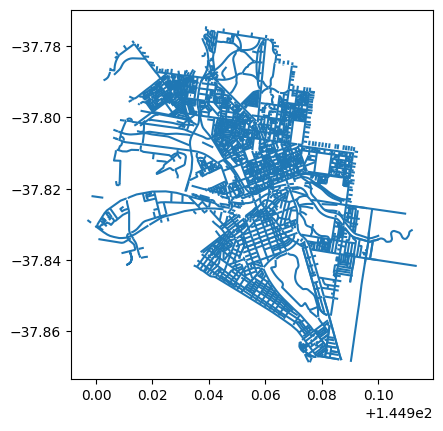

In [61]:
# Load the GeoJSON into a GeoDataFrame
gdf_street_name = gpd.read_file('street-names.geojson')

# Check the first few records to understand what the data looks like
print(gdf_street_name.head())

# Perform a quick plot to visualize
gdf_street_name.plot()

# Show the plot
plt.show()


In this code, I combine and visualize footpath steepness and street names in Melbourne using Folium, while also enabling interactive exploration through dropdown menus for selecting start and end streets.

First, I ensure that both the gdf_cleaned (footpath data) and gdf_street_name (street name data) GeoDataFrames are converted to the same Coordinate Reference System (CRS) suitable for mapping (EPSG:4326). I create a base map centered on Melbourne, with a close zoom level for detailed visualization.

The footpaths are added as a GeoJSON layer, colored blue to indicate their steepness (deltaz), with tooltips displaying the exact steepness values. The street names are overlaid in green, also with tooltips showing the street names.

Interactive dropdown menus allow users to select start and end streets. Upon selection, the map updates to display markers at the centroids of the selected streets, marked in blue for the start and green for the end. This interactive map provides a powerful tool for exploring pedestrian paths and street locations, facilitating urban planning and pedestrian route optimization based on footpath conditions.

In [62]:
# Convert both GeoDataFrames to the same CRS 
gdf_cleaned = gdf_cleaned.to_crs(epsg=4326)
gdf_street_name = gdf_street_name.to_crs(epsg=4326)

# Create base map centered around Melbourne
melbourne_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=14)

# Add the MULTIPOLYGON geometries (footpath steepness) to the map
folium.GeoJson(
    gdf_cleaned,
    name="Footpath Steepness",
    style_function=lambda x: {
        'fillColor': 'blue',
        'color': 'blue',
        'weight': 0.5,
        'fillOpacity': 0.1,
    },
    tooltip=folium.GeoJsonTooltip(fields=['deltaz'], aliases=['Delta Z:']),
).add_to(melbourne_map)

# Add the street names layer to the map
folium.GeoJson(
    gdf_street_name,
    name="Street Names",
    style_function=lambda x: {
        'color': 'green',
        'weight': 2,
        'opacity': 0.7,
    },
    tooltip=folium.GeoJsonTooltip(fields=['name'], aliases=['Street Name:']),
).add_to(melbourne_map)

# Add layer control to toggle layers
folium.LayerControl().add_to(melbourne_map)

# List of unique street names for the dropdown
street_names = sorted(gdf_street_name['name'].unique())

# Create dropdown widgets for selecting start and end streets
start_street_dropdown = widgets.Dropdown(
    options=street_names,
    description='Start Street:',
    style={'description_width': 'initial'}
)

end_street_dropdown = widgets.Dropdown(
    options=street_names,
    description='End Street:',
    style={'description_width': 'initial'}
)

def update_map(start_street, end_street):
    clear_output(wait=True)
         
    # Filter the street GeoDataFrame to get the geometries
    street_1_geom = gdf_street_name[gdf_street_name['name'] == start_street].geometry.values[0]
    street_2_geom = gdf_street_name[gdf_street_name['name'] == end_street].geometry.values[0]

    # Add markers for the selected start and end points
    folium.Marker([street_1_geom.centroid.y, street_1_geom.centroid.x], 
                  popup=f"Start: {start_street}", 
                  icon=folium.Icon(color='blue')).add_to(melbourne_map)
    
    folium.Marker([street_2_geom.centroid.y, street_2_geom.centroid.x], 
                  popup=f"End: {end_street}", 
                  icon=folium.Icon(color='green')).add_to(melbourne_map)

    # Update the map with the new markers
    display(melbourne_map)

# Display the dropdowns and plot the paths based on selection
widgets.interact(update_map, start_street=start_street_dropdown, end_street=end_street_dropdown);


interactive(children=(Dropdown(description='Start Street:', options=('(EASTERN HWY)', '206  BOURKE  STREET', "…

## Finding shortest routes using map

In this code, I leverage OpenRouteService (ORS) to create an interactive map that displays walking routes between selected streets in Melbourne, taking into account footpath steepness. By setting up the ORS client with a secure API key and ensuring that both footpath and street name GeoDataFrames are in the correct coordinate system, I enable accurate routing. The map dynamically updates based on user selections from dropdown menus, showing the calculated route in red with markers for the start and end points. The overlay of footpath steepness data allows users to assess routes in the context of topographical challenges, making this tool valuable for urban planning and improving pedestrian safety.

In [66]:
# Load your OpenRouteService API key from environment
api_key = os.environ.get("API_KEY_ORS")
ors_client = openrouteservice.Client(key=api_key)

# Ensure both GeoDataFrames have the correct CRS
gdf_cleaned = gdf_cleaned.to_crs(epsg=4326)
gdf_street_name = gdf_street_name.to_crs(epsg=4326)

# Function to query ORS for a route
def get_route(start_coords, end_coords):
    # Query the ORS API for a route
    route = ors_client.directions(
        coordinates=[start_coords, end_coords],
        profile='foot-walking',
        format='geojson'
    )
    return route

# Function to create a base map with footpath steepness data
def create_base_map():
    base_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=14)

    # Add GeoDataFrame with footpath steepness data
    folium.GeoJson(
        gdf_cleaned,
        name="Footpath Steepness",
        style_function=lambda x: {
            'fillColor': 'blue',
            'color': 'blue',
            'weight': 0.5,
            'fillOpacity': 0.1,
        }
    ).add_to(base_map)
    
    return base_map

# Function to update the map based on selected start and end streets
def update_map(start_street, end_street):
    # Create a fresh base map
    melbourne_map = create_base_map()
    
    # Filter the street GeoDataFrame to get the geometries
    street_1_geom = gdf_street_name[gdf_street_name['name'] == start_street].geometry.values[0]
    street_2_geom = gdf_street_name[gdf_street_name['name'] == end_street].geometry.values[0]

    # Get the centroid of the start and end streets
    start_coords = [street_1_geom.centroid.x, street_1_geom.centroid.y]
    end_coords = [street_2_geom.centroid.x, street_2_geom.centroid.y]

    # Get the route from ORS
    route = get_route(start_coords, end_coords)

    # Add the route to the map
    folium.GeoJson(route, name="ORS Route", style_function=lambda x: {'color': 'red', 'weight': 5}).add_to(melbourne_map)
    
    # Add markers for the selected start and end points
    folium.Marker([start_coords[1], start_coords[0]], 
                  popup=f"Start: {start_street}", 
                  icon=folium.Icon(color='blue')).add_to(melbourne_map)
    
    folium.Marker([end_coords[1], end_coords[0]], 
                  popup=f"End: {end_street}", 
                  icon=folium.Icon(color='green')).add_to(melbourne_map)

    # Add a layer control to toggle layers
    folium.LayerControl().add_to(melbourne_map)

    # Display the updated map
    display(melbourne_map)

# List of unique street names for the dropdown
street_names = sorted(gdf_street_name['name'].unique())

# Create dropdown widgets for selecting start and end streets
start_street_dropdown = widgets.Dropdown(
    options=street_names,
    description='Start Street:',
    style={'description_width': 'initial'}
)

end_street_dropdown = widgets.Dropdown(
    options=street_names,
    description='End Street:',
    style={'description_width': 'initial'}
)

# Display the dropdowns and update the map based on selections
widgets.interact(update_map, start_street=start_street_dropdown, end_street=end_street_dropdown)

interactive(children=(Dropdown(description='Start Street:', options=('(EASTERN HWY)', '206  BOURKE  STREET', "…

<function __main__.update_map(start_street, end_street)>

In this code, I integrate OpenRouteService (ORS) to create an interactive map that allows users to select start and end streets in Melbourne and visualize the best walking route between them. I first set up the ORS client with an API key and ensure that the footpath and street name GeoDataFrames are in the correct coordinate system (EPSG:4326) for mapping. The footpaths are styled based on their steepness, using different colors to indicate varying degrees of incline. The get_route function calculates the walking route between selected streets, which is then displayed on a base map centered around Melbourne. The map updates dynamically based on user-selected streets from dropdown menus, showing the calculated route with markers for start and end points. This interactive tool provides a clear visualization of pedestrian paths, enhancing urban planning and navigation by considering both distance and topographical challenges.

In [64]:
# Set up your OpenRouteService client with API key
api_key= os.environ.get("API_KEY_ORS")
ors_client = openrouteservice.Client(api_key)

# Convert both GeoDataFrames to the same CRS if they aren't already
gdf_cleaned = gdf_cleaned.to_crs(epsg=4326)
gdf_street_name = gdf_street_name.to_crs(epsg=4326)

# Function to style each polygon based on deltaz
def style_function(feature):
    deltaz = feature['properties']['deltaz']
    
    if deltaz > 20:
        color = '#ff0000'  # Red for very steep paths
    elif deltaz > 15:
        color = '#ff6600'  # Orange for moderately steep paths
    elif deltaz > 10:
        color = '#ffcc00'  # Yellow for slightly steep paths
    elif deltaz > 5:
        color = '#66ff66'  # Light green for gentle slopes
    elif deltaz > 2:
        color = '#66ffff'  # Light blue for very gentle slopes
    else:
        color = '#0000ff'  # Blue for flat or nearly flat paths
    
    return {
        'fillColor': color,
        'color': color,
        'weight': 0.5,
        'fillOpacity': 0.6,
    }

# Function to get a route from ORS
def get_route(start_coords, end_coords):
    # Query the ORS API for a route
    route = ors_client.directions(
        coordinates=[start_coords, end_coords],
        profile='foot-walking',  # Choose the appropriate profile, e.g., foot-walking
        format='geojson'
    )
    return route

# Create base map centered around the area of interest
def create_base_map():
    base_map = folium.Map(location=[-37.8136, 144.9631], zoom_start=14)

    # Add your footpath steepness data
    folium.GeoJson(
        gdf_cleaned,
        name="Footpath Steepness",
        style_function=style_function,
        tooltip=folium.GeoJsonTooltip(fields=['deltaz'], aliases=['Delta Z:']),
    ).add_to(base_map)
    
    return base_map

# Function to update the map based on selected start and end streets
def update_map(start_street, end_street):
    # Create a fresh base map each time to ensure it's updated
    melbourne_map = create_base_map()
    
    # Filter the street GeoDataFrame to get the geometries
    street_1_geom = gdf_street_name[gdf_street_name['name'] == start_street].geometry.values[0]
    street_2_geom = gdf_street_name[gdf_street_name['name'] == end_street].geometry.values[0]

    # Get the centroid of the start and end streets
    start_coords = [street_1_geom.centroid.x, street_1_geom.centroid.y]
    end_coords = [street_2_geom.centroid.x, street_2_geom.centroid.y]

    # Get the route from ORS
    route = get_route(start_coords, end_coords)

    # Add the route to the map
    folium.GeoJson(route, name="ORS Route", style_function=lambda x: {'color': 'red', 'weight': 5}).add_to(melbourne_map)
    
    # Add markers for the selected start and end points
    folium.Marker([start_coords[1], start_coords[0]], 
                  popup=f"Start: {start_street}", 
                  icon=folium.Icon(color='blue')).add_to(melbourne_map)
    
    folium.Marker([end_coords[1], end_coords[0]], 
                  popup=f"End: {end_street}", 
                  icon=folium.Icon(color='green')).add_to(melbourne_map)

    # Add a layer control to toggle layers
    folium.LayerControl().add_to(melbourne_map)

    # Display the updated map
    display(melbourne_map)

# List of unique street names for the dropdown
street_names = sorted(gdf_street_name['name'].unique())

# Create dropdown widgets for selecting start and end streets
start_street_dropdown = widgets.Dropdown(
    options=street_names,
    description='Start Street:',
    style={'description_width': 'initial'}
)

end_street_dropdown = widgets.Dropdown(
    options=street_names,
    description='End Street:',
    style={'description_width': 'initial'}
)

# Display the dropdowns and update the map based on selections
widgets.interact(update_map, start_street=start_street_dropdown, end_street=end_street_dropdown);


interactive(children=(Dropdown(description='Start Street:', options=('(EASTERN HWY)', '206  BOURKE  STREET', "…

In this code, I develop an interactive tool for visualizing and analyzing pedestrian routes in Melbourne using Folium and OpenRouteService (ORS). The tool begins with logging setup and API integration to fetch walking routes between selected streets. I prepare the geospatial data by converting footpath and street name GeoDataFrames to the appropriate coordinate system (EPSG:4326). Footpaths are visually styled based on elevation changes, offering a clear representation of steepness. The ORS API provides multiple route options, and the code calculates the total elevation change (delta Z) for each, identifying the route with the least elevation gain. An interactive map updates dynamically based on user-selected start and end streets, highlighting the best route and displaying visual markers for key points. This tool effectively combines geospatial data analysis with real-time interactivity, offering a valuable resource for urban planning and pedestrian route optimization in Melbourne.

In [68]:


# Set up logging for debugging purposes
logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

# Initialize OpenRouteService client with your API key
api_key= os.environ.get("API_KEY_ORS")
ors_client = openrouteservice.Client(api_key)


# Ensure both GeoDataFrames use the same CRS
desired_crs = 'EPSG:4326'  # WGS84 Latitude/Longitude
gdf_cleaned = gdf_cleaned.to_crs(desired_crs)
gdf_street_name = gdf_street_name.to_crs(desired_crs)

# Define a function to style footpath polygons based on delta Z values
def style_function(feature):
    deltaz = feature['properties'].get('deltaz', 0)
    
    if deltaz > 20:
        color = '#ff0000'  # Red
    elif deltaz > 15:
        color = '#ff6600'  # Orange
    elif deltaz > 10:
        color = '#ffcc00'  # Yellow
    elif deltaz > 5:
        color = '#66ff66'  # Light green
    elif deltaz > 2:
        color = '#66ffff'  # Light blue
    else:
        color = '#0000ff'  # Blue
    
    return {
        'fillColor': color,
        'color': color,
        'weight': 1,
        'fillOpacity': 0.6,
    }

# Function to retrieve routes from ORS API
def get_routes(start_coords, end_coords):
    try:
        # Request routes with up to 3 alternatives
        routes = ors_client.directions(
            coordinates=[start_coords, end_coords],
            profile='foot-walking',
            format='geojson',
            alternative_routes={'share_factor': 0.8, 'target_count': 3},
            elevation=True  # Include elevation data
        )
        return routes['features']
    except openrouteservice.exceptions.ApiError as e:
        logger.error(f"ORS API Error: {e}")
        return None
    except Exception as e:
        logger.error(f"Unexpected error: {e}")
        return None

# Function to calculate total delta Z (elevation change) along a route
def calculate_delta_z(route):
    try:
        # Extract coordinates from the route geometry
        coordinates = route['geometry']['coordinates']
        
        # Calculate elevation differences between consecutive points
        elevations = [point[2] for point in coordinates if len(point) == 3]
        if not elevations:
            logger.warning("Elevation data missing in route geometry.")
            return np.inf  # Assign high value if elevation data is missing
        
        delta_z = sum(abs(elevations[i+1] - elevations[i]) for i in range(len(elevations)-1))
        return delta_z
    except Exception as e:
        logger.error(f"Error calculating delta Z: {e}")
        return np.inf

# Function to select the best route based on minimum delta Z
def get_best_route(routes):
    try:
        best_route = None
        min_delta_z = np.inf
        
        for route in routes:
            delta_z = calculate_delta_z(route)
            logger.info(f"Route ID {route['properties']['summary']['distance']} meters: Delta Z = {delta_z}")
            if delta_z < min_delta_z:
                min_delta_z = delta_z
                best_route = route
        
        return best_route
    except Exception as e:
        logger.error(f"Error selecting best route: {e}")
        return None

# Function to create the base map
def create_base_map(center_coords):
    base_map = folium.Map(location=center_coords, zoom_start=14, control_scale=True)
    
    # Add footpath steepness layer
    folium.GeoJson(
        gdf_cleaned,
        name="Footpath Steepness",
        style_function=style_function,
        tooltip=folium.GeoJsonTooltip(fields=['deltaz'], aliases=['Delta Z:'])
    ).add_to(base_map)
    
    return base_map

# Main function to update and display the map based on selected streets
def update_map(start_street, end_street):
    try:
        # Get geometries for selected streets
        start_geom = gdf_street_name[gdf_street_name['name'] == start_street].geometry.unary_union
        end_geom = gdf_street_name[gdf_street_name['name'] == end_street].geometry.unary_union
        
        if start_geom.is_empty or end_geom.is_empty:
            logger.error("Selected streets do not have valid geometries.")
            return
        
        # Get centroid coordinates for start and end points
        start_point = start_geom.centroid
        end_point = end_geom.centroid
        
        start_coords = [start_point.x, start_point.y]
        end_coords = [end_point.x, end_point.y]
        
        # Create base map centered between start and end points
        center_coords = [(start_coords[1] + end_coords[1]) / 2, (start_coords[0] + end_coords[0]) / 2]
        map_object = create_base_map(center_coords)
        
        # Retrieve routes from ORS API
        routes = get_routes(start_coords, end_coords)
        if not routes:
            logger.error("No routes found between selected points.")
            return
        
        # Variables to keep track of the best route
        best_route = None
        best_delta_z = np.inf
        
        # Define colors for each route
        route_colors = ['red', 'blue', 'green', 'purple', 'orange']
        
        # Loop through all the routes
        for i, route in enumerate(routes):
            delta_z = calculate_delta_z(route)
            logger.info(f"Route {i+1} - Distance: {route['properties']['segments'][0]['distance']} meters: Delta Z = {delta_z}")
            
            # Add the route to the map
            folium.GeoJson(
                route,
                name=f"Route {i+1} - ΔZ: {delta_z:.2f} m",
                style_function=lambda x, color=route_colors[i % len(route_colors)]: {
                    'color': color,
                    'weight': 5 if delta_z < best_delta_z else 3,
                    'opacity': 1.0 if delta_z < best_delta_z else 0.7
                }
            ).add_to(map_object)
            
            # Check if this route has the lowest delta Z
            if delta_z < best_delta_z:
                best_delta_z = delta_z
                best_route = route
        
        # Add markers for start and end points
        folium.Marker(
            location=[start_coords[1], start_coords[0]],
            popup=f"Start: {start_street}",
            icon=folium.Icon(color='blue', icon='play')
        ).add_to(map_object)
        
        folium.Marker(
            location=[end_coords[1], end_coords[0]],
            popup=f"End: {end_street}",
            icon=folium.Icon(color='red', icon='stop')
        ).add_to(map_object)
        
        # Add layer control
        folium.LayerControl().add_to(map_object)
        
        # Display the map
        display(map_object)
        
    except Exception as e:
        logger.error(f"Error updating map: {e}")

# Prepare street names for dropdown widgets
street_names = sorted(gdf_street_name['name'].dropna().unique())

# Create interactive widgets for selecting start and end streets
start_street_widget = widgets.Dropdown(
    options=street_names,
    description='Start Street:',
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='50%')
)

end_street_widget = widgets.Dropdown(
    options=street_names,
    description='End Street:',
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='50%')
)

# Display interactive widgets and map
ui = widgets.HBox([start_street_widget, end_street_widget])
out = widgets.interactive_output(update_map, {'start_street': start_street_widget, 'end_street': end_street_widget})

display(ui, out)


Output()

# Conclusion

This project aims to enhance pedestrian safety in Melbourne's urban areas by analyzing footpath steepness, weather conditions, and traffic patterns to provide safer walking routes. The study begins by cleaning and preparing a GeoDataFrame containing footpath data, focusing on attributes such as grade, elevation change, and distance, while removing entries with insufficient information. The cleaned data is visualized using interactive maps to highlight areas with varying levels of footpath steepness, which could impact pedestrian safety, particularly for vulnerable groups.

To further refine the safety analysis, the study integrates weather conditions and traffic patterns, examining their correlation with pedestrian movement and safety. By analyzing these additional factors, the study provides a more comprehensive understanding of the environmental and contextual risks faced by pedestrians. A regression model is implemented to quantify the relationship between these variables, predicting pedestrian safety under different conditions.

The project also utilizes OpenRouteService (ORS) to create an interactive tool that allows users to select start and end points and generate the safest walking routes, taking into account footpath conditions, weather data, and traffic patterns. This dynamic routing tool offers practical applications for both urban planners and the general public, promoting safer pedestrian navigation in Melbourne. Future iterations could incorporate real-time data updates and expand the model to consider additional factors, such as lighting and pedestrian density, further enhancing its accuracy and utility.

# References

- Footpath steepness. (2023). Vic.gov.au. https://data.melbourne.vic.gov.au/explore/dataset/footpath-steepness/information/
- Pedestrian Counting System (counts per hour). (2023). Vic.gov.au. https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-counting-system-monthly-counts-per-hour/information/
- Pedestrian Counting System - Past Hour (counts per minute). (2020). Vic.gov.au. https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-counting-system-past-hour-counts-per-minute/information/
- Pedestrian Counting System - Sensor Locations. (2023). Vic.gov.au. https://data.melbourne.vic.gov.au/explore/dataset/pedestrian-counting-system-sensor-locations/information/
- Street names. (2023). Vic.gov.au. https://data.melbourne.vic.gov.au/explore/dataset/street-names/information/
- Microclimate sensors data. (2023). Vic.gov.au. https://data.melbourne.vic.gov.au/explore/dataset/microclimate-sensors-data/information/
- Climate API | Open-Meteo.com. (2015). Open-Meteo.com. https://open-meteo.com/en/docs/climate-api
- openrouteservice. (2019). Openrouteservice.org. https://openrouteservice.org/
- scikit-learn: machine learning in Python — scikit-learn 1.5.2 documentation. (2024). Scikit-Learn.org. https://scikit-learn.org/stable/
- Getting started with conda — conda 24.7.2.dev87 documentation. (2017). Conda.io. https://conda.io/projects/conda/en/latest/user-guide/getting-started.html
‌